24855


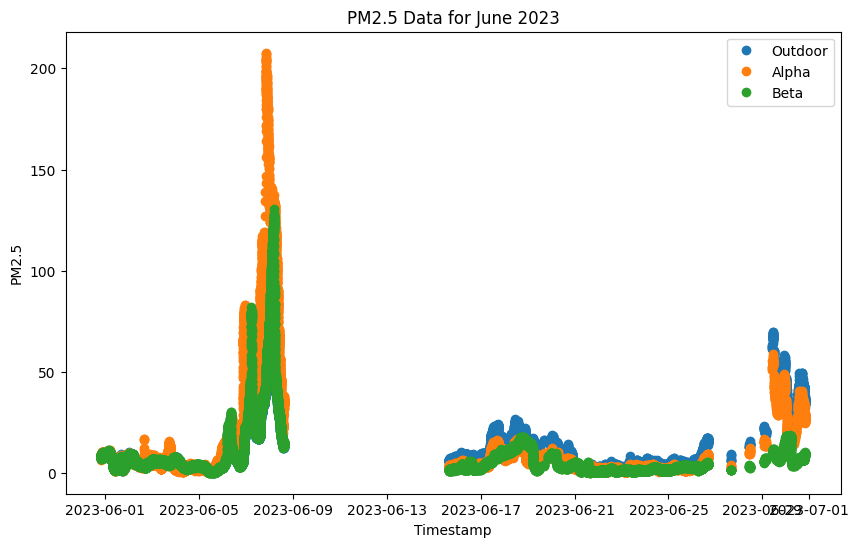

timestamp_local
2023-05-31 20:00:00+00:00     7.853
2023-05-31 20:01:00+00:00     7.744
2023-05-31 20:02:00+00:00     7.423
2023-05-31 20:03:00+00:00     8.013
2023-05-31 20:04:00+00:00     8.461
                              ...  
2023-06-30 19:42:00+00:00    33.797
2023-06-30 19:43:00+00:00    34.078
2023-06-30 19:44:00+00:00    34.344
2023-06-30 19:45:00+00:00    35.657
2023-06-30 19:46:00+00:00    33.850
Name: pm1, Length: 24852, dtype: float64


In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np
from datetime import datetime
from matplotlib.dates import DateFormatter
from scipy.optimize import curve_fit
import scipy.stats as stats
from scipy.optimize import curve_fit

# Define the polynomial function
def linear_func(x, a, b):
    return a * x + b

# Fit the data using curve_fit


# pm1_coefficients_alpha[0] will be the coefficient 'a', and pm1_coefficients_alpha[1] will be the coefficient 'b'.

# Import CSV file for each sensor
dfMod = pd.read_csv('outdoor_june.csv',parse_dates=['timestamp_local'],index_col='timestamp_local')
dfAlp = pd.read_csv('alpha_june.csv',parse_dates=['timestamp_local'],index_col='timestamp_local')
dfBet = pd.read_csv('beta_june.csv',parse_dates=['timestamp_local'],index_col='timestamp_local')

# Round down the seconds to the nearest minute for each DataFrame
dfMod.index = dfMod.index.map(lambda x: x.replace(second=0))
dfAlp.index = dfAlp.index.map(lambda x: x.replace(second=0))
dfBet.index = dfBet.index.map(lambda x: x.replace(second=0))

# Find the common timestamps after rounding down the seconds
common_timestamps = dfMod.index.intersection(dfAlp.index).intersection(dfBet.index)

# Filter each DataFrame to keep only the rows with common timestamps
dfMod = dfMod[dfMod.index.isin(common_timestamps)]
dfAlp = dfAlp[dfAlp.index.isin(common_timestamps)]
dfBet = dfBet[dfBet.index.isin(common_timestamps)]



# Specify the date range (converted to the same timezone as DataFrame index, if needed)
# start_date = pd.Timestamp('2023-06-01T23:59:00Z')
# end_date = pd.Timestamp('2023-06-15T23:59:00Z')

# # Filter the DataFrames based on the specified date range
# dfMod = dfMod.loc[start_date:end_date]
# dfAlp = dfAlp.loc[start_date:end_date]
# dfBet = dfBet.loc[start_date:end_date]

print(len(dfMod))
dfMod = dfMod.sort_index(ascending=True)
dfAlp = dfAlp.sort_index(ascending=True)
dfBet = dfBet.sort_index(ascending=True)
dfMod = dfMod.drop_duplicates()
# Remove duplicates from the index of humidity_ground_truth

# Remove duplicates from the indices of sensor DataFrames
dfAlp = dfAlp[~dfAlp.index.duplicated()]
dfBet = dfBet[~dfBet.index.duplicated()]


dfMod = dfMod[:len(dfAlp)]
dfBet = dfBet[:len(dfAlp)]

fig, ax = plt.subplots(figsize=(10,6))
ax.plot(dfMod.index, dfMod['pm25'], 'o', label='Outdoor')
ax.plot(dfAlp.index, dfAlp['pm25'], 'o', label='Alpha')
ax.plot(dfBet.index, dfBet['pm25'], 'o', label='Beta')

# Add labels, title, legend, etc.
plt.xlabel('Timestamp')
plt.ylabel('PM2.5')
plt.title('PM2.5 Data for June 2023')
plt.legend()
plt.show()

humidity_ground_truth = dfMod['rh']
temperature_ground_truth = dfMod['temp']
pm25_ground_truth = dfMod['pm25']
pm10_ground_truth = dfMod['pm10']
pm1_ground_truth = dfMod['pm1']
print(pm1_ground_truth)




  


In [3]:
humidity_data = {
 
   'alpha_sensor': dfAlp['sample_rh'],
   'beta_sensor': dfBet['sample_rh']
}

temp_data = {
   'alpha_sensor': dfAlp['sample_temp'],
   'beta_sensor': dfBet['sample_temp']

}
pm1_data = {
   'alpha_sensor': dfAlp['pm1'],
   'beta_sensor': dfBet['pm1']
}

pm25_data = {
   'alpha_sensor': dfAlp['pm25'],
   'beta_sensor': dfBet['pm25']
}
pm10_data = {
   'alpha_sensor': dfAlp['pm10'],
   'beta_sensor': dfBet['pm10']
}
humidity_df = pd.DataFrame(humidity_data)
temp_df = pd.DataFrame(temp_data)
pm1_df = pd.DataFrame(pm1_data)
pm25_df = pd.DataFrame(pm25_data)
pm10_df = pd.DataFrame(pm10_data)


In [4]:
print(pm10_df['alpha_sensor'])
print(pm10_ground_truth)


humidity_coefficients_alpha = np.polyfit(humidity_ground_truth, humidity_df['alpha_sensor'], 1)
humidity_coefficients_beta = np.polyfit(humidity_ground_truth, humidity_df['beta_sensor'], 1)

temperature_coefficients_alpha = np.polyfit(temperature_ground_truth, temp_df['alpha_sensor'], 1)
temperature_coefficients_beta = np.polyfit(temperature_ground_truth, temp_df['beta_sensor'], 1)

pm1_coefficients_alpha,_= curve_fit(linear_func, pm1_ground_truth, pm1_df['alpha_sensor'])
pm1_coefficients_beta,_ =curve_fit(linear_func, pm1_ground_truth, pm1_df['beta_sensor'])


pm25_coefficients_alpha,_ = curve_fit(linear_func, pm25_ground_truth, pm25_df['alpha_sensor'])
pm25_coefficients_beta,_ = curve_fit(linear_func, pm25_ground_truth, pm25_df['beta_sensor'])

pm10_coefficients_alpha,_ = curve_fit(linear_func, pm10_ground_truth, pm10_df['alpha_sensor'])
pm10_coefficients_beta,_ = curve_fit(linear_func, pm10_ground_truth, pm10_df['beta_sensor'])



humidity_bias_alpha = humidity_coefficients_alpha[1]
humidity_bias_beta = humidity_coefficients_beta[1]

temperature_bias_alpha = temperature_coefficients_alpha[1]
temperature_bias_beta = temperature_coefficients_beta[1]

pm1_bias_alpha = pm1_coefficients_alpha[1]
pm1_bias_beta = pm1_coefficients_beta[1]

pm25_bias_alpha = pm25_coefficients_alpha[1]
pm25_bias_beta = pm25_coefficients_beta[1]

pm10_bias_alpha = pm10_coefficients_alpha[1]
pm10_bias_beta = pm10_coefficients_beta[1]




timestamp_local
2023-05-31 20:00:00+00:00     8.329
2023-05-31 20:01:00+00:00     8.537
2023-05-31 20:02:00+00:00     8.449
2023-05-31 20:03:00+00:00     8.800
2023-05-31 20:04:00+00:00     8.097
                              ...  
2023-06-30 19:45:00+00:00    27.928
2023-06-30 19:46:00+00:00    26.505
2023-06-30 19:47:00+00:00    28.761
2023-06-30 19:48:00+00:00    27.421
2023-06-30 19:59:00+00:00    26.380
Name: alpha_sensor, Length: 24852, dtype: float64
timestamp_local
2023-05-31 20:00:00+00:00     7.942
2023-05-31 20:01:00+00:00     8.026
2023-05-31 20:02:00+00:00     7.449
2023-05-31 20:03:00+00:00     8.151
2023-05-31 20:04:00+00:00     8.894
                              ...  
2023-06-30 19:42:00+00:00    34.358
2023-06-30 19:43:00+00:00    34.697
2023-06-30 19:44:00+00:00    35.021
2023-06-30 19:45:00+00:00    37.433
2023-06-30 19:46:00+00:00    36.718
Name: pm10, Length: 24852, dtype: float64


/home/sami/.local/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


In [5]:
humidity_measurement_matrix_alpha = np.array([[1, 0],  # For the ground truth humidity_alpha
                                             [0, 1]])
humidity_measurement_matrix_beta = np.array([[1, 0],  # For the ground truth humidity_beta
                                             [0, 1]])

temperature_measurement_matrix_alpha = np.array([[1, 0],  # For the ground truth temperature_alpha
                                                 [0, 1]])
temperature_measurement_matrix_beta = np.array([[1, 0],  # For the ground truth temperature_beta
                                                [0, 1]])

pm1_measurement_matrix_alpha = np.array([[1, 0],  # For the ground truth pm1_alpha
                                         [0, 1]])
pm1_measurement_matrix_beta = np.array([[1, 0],  # For the ground truth pm1_beta
                                        [0, 1]])

pm25_measurement_matrix_alpha = np.array([[1, 0],  # For the ground truth pm25_alpha
                                          [0, 1]])
pm25_measurement_matrix_beta = np.array([[1, 0],  # For the ground truth pm25_beta
                                         [0, 1]])

pm10_measurement_matrix_alpha = np.array([[1, 0],  # For the ground truth pm10_alpha
                                            [0, 1]])    
pm10_measurement_matrix_beta = np.array([[1, 0],  # For the ground truth pm10_beta
                                            [0, 1]])


In [6]:


humidity_noise_covariance_matrix_alpha = np.diag([1, 1])
humidity_noise_covariance_matrix_beta = np.diag([1, 1])


temperature_noise_covariance_matrix_alpha = np.diag([1, 1])
temperature_noise_covariance_matrix_beta = np.diag([1, 1])

pm1_noise_covariance_matrix_alpha = np.diag([1, 1])
pm1_noise_covariance_matrix_beta = np.diag([1, 1])


pm25_noise_covariance_matrix_alpha = np.diag([1, 1])
pm25_noise_covariance_matrix_beta = np.diag([1, 1])


pm10_noise_covariance_matrix_alpha = np.diag([1, 1])
pm10_noise_covariance_matrix_beta = np.diag([1, 1])

In [7]:
humidity_initial_state_alpha = [humidity_df['alpha_sensor'][0],humidity_bias_alpha]
humidity_initial_state_beta = [humidity_df['beta_sensor'][0],humidity_bias_beta]

temperature_initial_state_alpha = [temp_df['alpha_sensor'][0],temperature_bias_alpha]
temperature_initial_state_beta = [temp_df['beta_sensor'][0],temperature_bias_beta]

pm1_initial_state_alpha = [pm1_df['alpha_sensor'][0],pm1_bias_alpha]
pm1_initial_state_beta = [pm1_df['beta_sensor'][0],pm1_bias_beta]

pm25_initial_state_alpha = [pm25_df['alpha_sensor'][0],pm25_bias_alpha]
pm25_initial_state_beta = [pm25_df['beta_sensor'][0],pm25_bias_beta]

pm10_initial_state_alpha = [pm10_df['alpha_sensor'][0],pm10_bias_alpha]
pm10_initial_state_beta = [pm10_df['beta_sensor'][0],pm10_bias_beta]

In [8]:
humidity_process_noise_covariance_alpha = np.diag([.5, .5])
humidity_process_noise_covariance_beta = np.diag([.5, .5])

temperature_process_noise_covariance_alpha = np.diag([.5, .5])
temperature_process_noise_covariance_beta = np.diag([.5, .5])

pm1_process_noise_covariance_alpha = np.diag([.5, .5])
pm1_process_noise_covariance_beta = np.diag([.5, .5])

pm25_process_noise_covariance_alpha = np.diag([.5, .5])
pm25_process_noise_covariance_beta = np.diag([.5, .5])

pm10_process_noise_covariance_alpha = np.diag([.5, .5])
pm10_process_noise_covariance_beta = np.diag([.5, .5])


In [9]:

humidity_state_estimate_alpha = np.array(humidity_initial_state_alpha)
humidity_state_estimate_beta = np.array(humidity_initial_state_beta)

temperature_state_estimate_alpha = np.array(temperature_initial_state_alpha)
temperature_state_estimate_beta = np.array(temperature_initial_state_beta)

pm1_state_estimate_alpha = np.array(pm1_initial_state_alpha)
pm1_state_estimate_beta = np.array(pm1_initial_state_beta)

pm25_state_estimate_alpha = np.array(pm25_initial_state_alpha)
pm25_state_estimate_beta = np.array(pm25_initial_state_beta)

pm10_state_estimate_alpha = np.array(pm10_initial_state_alpha)
pm10_state_estimate_beta = np.array(pm10_initial_state_beta)

In [10]:
humidity_covariance_estimate_alpha = np.diag([.1, 1])  
humidity_covariance_estimate_beta = np.diag([.1, 1])

temperature_covariance_estimate_alpha = np.diag([.1, 1])
temperature_covariance_estimate_beta = np.diag([.1, 1])

pm1_covariance_estimate_alpha = np.diag([.1, 1])
pm1_covariance_estimate_beta = np.diag([.1, 1])

pm25_covariance_estimate_alpha = np.diag([.1, 1])
pm25_covariance_estimate_beta = np.diag([.1, 1])

pm10_covariance_estimate_alpha = np.diag([.1, 1])
pm10_covariance_estimate_beta = np.diag([.1, 1])



In [11]:
filtered_humidity_alpha = []
filtered_humidity_beta = []

filtered_temperature_alpha = []
filtered_temperature_beta = []

filtered_pm1_alpha = []
filtered_pm1_beta = []

filtered_pm25_alpha = []
filtered_pm25_beta = []

filtered_pm10_alpha = []
filtered_pm10_beta = []


In [12]:
humidity_counter_alpha=0
for measurement_alpha in humidity_df['alpha_sensor']:
    if  humidity_counter_alpha < dfAlp.index.size-1:
        humidity_counter_alpha = humidity_counter_alpha + 1

    delta_time_alpha = dfAlp.index[humidity_counter_alpha] - dfAlp.index[humidity_counter_alpha-1]
    
    # Kalman filter predict and update steps
    humidity_state_transition_alpha = np.array([[1, delta_time_alpha.seconds / 60],
                                          [0, 1]])
    humidity_state_estimate_alpha = np.dot(humidity_state_transition_alpha, humidity_state_estimate_alpha)
    humidity_covariance_estimate_alpha = np.dot(np.dot(humidity_state_transition_alpha, humidity_covariance_estimate_alpha), humidity_state_transition_alpha.T) + humidity_process_noise_covariance_alpha
    measurement_vector_alpha = np.array([humidity_ground_truth[humidity_counter_alpha], 1]) # Add the ground truth measurements
      # Update Step
    measurement_residual_alpha = measurement_vector_alpha - np.dot(humidity_measurement_matrix_alpha, humidity_state_estimate_alpha)

    # Adjust the humidity_noise_covariance_matrix for the additional measurements
    humidity_noise_covariance_matrix_adjusted_alpha = np.diag([.1, .1])


    kalman_gain_alpha = np.dot(np.dot(humidity_covariance_estimate_alpha, humidity_measurement_matrix_alpha.T), np.linalg.inv(np.dot(np.dot(humidity_measurement_matrix_alpha, humidity_covariance_estimate_alpha), humidity_measurement_matrix_alpha.T) + humidity_noise_covariance_matrix_adjusted_alpha))
    humidity_state_estimate_alpha = humidity_state_estimate_alpha+ np.dot(kalman_gain_alpha, measurement_residual_alpha)
    humidity_covariance_estimate_alpha = np.dot((np.eye(2) - np.dot(kalman_gain_alpha, humidity_measurement_matrix_alpha)), humidity_covariance_estimate_alpha)

    # Extract humidity estimates and biases from the state vector
    humidity_alpha_estimate = humidity_state_estimate_alpha[0]
    humidity_bias_alpha_estimate = humidity_state_estimate_alpha[1]
 

    # Output the estimates
    print(f"Alpha Sensor: Measured Humidity: {measurement_alpha:.2f}, Estimated Humidity: {humidity_alpha_estimate:.2f}, Bias Estimate: {humidity_bias_alpha_estimate:.2f}")

    filtered_humidity_alpha.append(humidity_alpha_estimate)

print(len(filtered_humidity_alpha))
dfAlp['filtered_humidity'] = filtered_humidity_alpha



Alpha Sensor: Measured Humidity: 34.97, Estimated Humidity: 33.95, Bias Estimate: 0.81
Alpha Sensor: Measured Humidity: 34.96, Estimated Humidity: 33.93, Bias Estimate: 0.96
Alpha Sensor: Measured Humidity: 34.95, Estimated Humidity: 33.94, Bias Estimate: 0.98
Alpha Sensor: Measured Humidity: 34.95, Estimated Humidity: 33.95, Bias Estimate: 0.98
Alpha Sensor: Measured Humidity: 34.94, Estimated Humidity: 33.95, Bias Estimate: 0.98
Alpha Sensor: Measured Humidity: 34.95, Estimated Humidity: 33.95, Bias Estimate: 0.98
Alpha Sensor: Measured Humidity: 34.94, Estimated Humidity: 33.95, Bias Estimate: 0.98
Alpha Sensor: Measured Humidity: 34.93, Estimated Humidity: 33.95, Bias Estimate: 0.98
Alpha Sensor: Measured Humidity: 34.92, Estimated Humidity: 33.95, Bias Estimate: 0.98
Alpha Sensor: Measured Humidity: 34.91, Estimated Humidity: 33.95, Bias Estimate: 0.98
Alpha Sensor: Measured Humidity: 34.91, Estimated Humidity: 33.95, Bias Estimate: 0.98
Alpha Sensor: Measured Humidity: 34.90, Est

In [13]:
humidity_counter_beta=0
for measurement_beta in humidity_df['beta_sensor']:
    if humidity_counter_beta < dfBet.index.size-1:
        humidity_counter_beta = humidity_counter_beta + 1
    delta_time_beta = dfBet.index[humidity_counter_beta] - dfBet.index[humidity_counter_beta-1]


    # Kalman filter predict and update steps
    humidity_state_transition_beta = np.array([[1, delta_time_beta.seconds / 60],
                                            [0, 1]])
    humidity_state_estimate_beta = np.dot(humidity_state_transition_beta, humidity_state_estimate_beta)
    humidity_covariance_estimate_beta = np.dot(np.dot(humidity_state_transition_beta, humidity_covariance_estimate_beta), humidity_state_transition_beta.T) + humidity_process_noise_covariance_beta
    measurement_vector_beta = np.array([humidity_ground_truth[humidity_counter_beta], 1]) # Add the ground truth measurements
        # Update Step
    measurement_residual_beta = measurement_vector_beta - np.dot(humidity_measurement_matrix_beta, humidity_state_estimate_beta)

    # Adjust the humidity_noise_covariance_matrix for the additional measurements
    humidity_noise_covariance_matrix_adjusted_beta = np.diag([.1, .1])


    kalman_gain_beta = np.dot(np.dot(humidity_covariance_estimate_beta, humidity_measurement_matrix_beta.T), np.linalg.inv(np.dot(np.dot(humidity_measurement_matrix_beta, humidity_covariance_estimate_beta), humidity_measurement_matrix_beta.T) + humidity_noise_covariance_matrix_adjusted_beta))
    humidity_state_estimate_beta = humidity_state_estimate_beta+ np.dot(kalman_gain_beta, measurement_residual_beta)
    humidity_covariance_estimate_beta = np.dot((np.eye(2) - np.dot(kalman_gain_beta, humidity_measurement_matrix_beta)), humidity_covariance_estimate_beta)
    
    # Extract humidity estimates and biases from the state vector
    humidity_beta_estimate = humidity_state_estimate_beta[0]
    humidity_bias_beta_estimate = humidity_state_estimate_beta[1]

    # Output the estimates

    print(f"Beta Sensor: Measured Humidity: {measurement_beta:.2f}, Estimated Humidity: {humidity_beta_estimate:.2f}, Bias Estimate: {humidity_bias_beta_estimate:.2f}")
    
    filtered_humidity_beta.append(humidity_beta_estimate)


dfBet['filtered_humidity'] = filtered_humidity_beta

Beta Sensor: Measured Humidity: 35.01, Estimated Humidity: 34.35, Bias Estimate: 1.28
Beta Sensor: Measured Humidity: 35.00, Estimated Humidity: 34.03, Bias Estimate: 1.01
Beta Sensor: Measured Humidity: 35.01, Estimated Humidity: 33.96, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 35.00, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 35.00, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 34.98, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 34.99, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 34.96, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 34.96, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 34.94, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 34.95, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 34.95, Estimated Humid

In [14]:
temperature_counter_alpha=0
for measurement_alpha in temp_df['alpha_sensor']:
    if temperature_counter_alpha < dfAlp.index.size-1:
        temperature_counter_alpha = temperature_counter_alpha + 1
    delta_time_alpha = dfAlp.index[temperature_counter_alpha] - dfAlp.index[temperature_counter_alpha-1]


        # Kalman filter predict and update steps
    temperature_state_transition_alpha = np.array([[1, delta_time_alpha.seconds / 60],
                                                [0, 1]])
    temperature_state_estimate_alpha = np.dot(temperature_state_transition_alpha, temperature_state_estimate_alpha)
    temperature_covariance_estimate_alpha = np.dot(np.dot(temperature_state_transition_alpha, temperature_covariance_estimate_alpha), temperature_state_transition_alpha.T) + temperature_process_noise_covariance_alpha
    measurement_vector_alpha = np.array([temperature_ground_truth[temperature_counter_alpha], 0]) # Add the ground truth measurements
            # Update Step
    measurement_residual_alpha = measurement_vector_alpha - np.dot(temperature_measurement_matrix_alpha, temperature_state_estimate_alpha)

        # Adjust the temperature_noise_covariance_matrix for the additional measurements
    temperature_noise_covariance_matrix_adjusted_alpha = np.diag([.1, .1])


    kalman_gain_alpha = np.dot(np.dot(temperature_covariance_estimate_alpha, temperature_measurement_matrix_alpha.T), np.linalg.inv(np.dot(np.dot(temperature_measurement_matrix_alpha, temperature_covariance_estimate_alpha), temperature_measurement_matrix_alpha.T) + temperature_noise_covariance_matrix_adjusted_alpha))
    temperature_state_estimate_alpha = temperature_state_estimate_alpha+ np.dot(kalman_gain_alpha, measurement_residual_alpha)
    temperature_covariance_estimate_alpha = np.dot((np.eye(2) - np.dot(kalman_gain_alpha, temperature_measurement_matrix_alpha)), temperature_covariance_estimate_alpha)


        # Extract temperature estimates and biases from the state vector
    temperature_alpha_estimate = temperature_state_estimate_alpha[0]
    temperature_bias_alpha_estimate = temperature_state_estimate_alpha[1]

        # Output the estimates

    print(f"Alpha Sensor: Measured Temperature: {measurement_alpha:.2f}, Estimated Temperature: {temperature_alpha_estimate:.2f}, Bias Estimate: {temperature_bias_alpha_estimate:.2f}")

    filtered_temperature_alpha.append(temperature_alpha_estimate)

dfAlp['filtered_temperature'] = filtered_temperature_alpha

Alpha Sensor: Measured Temperature: 25.56, Estimated Temperature: 26.61, Bias Estimate: 0.88
Alpha Sensor: Measured Temperature: 25.57, Estimated Temperature: 26.09, Bias Estimate: 0.10
Alpha Sensor: Measured Temperature: 25.58, Estimated Temperature: 25.94, Bias Estimate: 0.01
Alpha Sensor: Measured Temperature: 25.59, Estimated Temperature: 25.91, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.58, Estimated Temperature: 25.90, Bias Estimate: -0.00
Alpha Sensor: Measured Temperature: 25.59, Estimated Temperature: 25.90, Bias Estimate: -0.00
Alpha Sensor: Measured Temperature: 25.60, Estimated Temperature: 25.99, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.59, Estimated Temperature: 26.00, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.60, Estimated Temperature: 26.00, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.61, Estimated Temperature: 26.00, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.61, Estimated Temperature: 26

In [15]:
temperature_counter_beta=0
for measurement_beta in temp_df['beta_sensor']:

    if temperature_counter_beta < dfBet.index.size-1:
        temperature_counter_beta = temperature_counter_beta + 1
    delta_time_beta = dfBet.index[temperature_counter_beta] - dfBet.index[temperature_counter_beta-1]


        # Kalman filter predict and update steps
    temperature_state_transition_beta = np.array([[1, delta_time_beta.seconds / 60],
                                                [0, 1]])
    temperature_state_estimate_beta = np.dot(temperature_state_transition_beta, temperature_state_estimate_beta)
    temperature_covariance_estimate_beta = np.dot(np.dot(temperature_state_transition_beta, temperature_covariance_estimate_beta), temperature_state_transition_beta.T) + temperature_process_noise_covariance_beta
    measurement_vector_beta = np.array([temperature_ground_truth[temperature_counter_beta], 0]) # Add the ground truth measurements
            # Update Step
    measurement_residual_beta = measurement_vector_beta - np.dot(temperature_measurement_matrix_beta, temperature_state_estimate_beta)


        # Adjust the temperature_noise_covariance_matrix for the additional measurements    
    temperature_noise_covariance_matrix_adjusted_beta = np.diag([.1, .1])


    kalman_gain_beta = np.dot(np.dot(temperature_covariance_estimate_beta, temperature_measurement_matrix_beta.T), np.linalg.inv(np.dot(np.dot(temperature_measurement_matrix_beta, temperature_covariance_estimate_beta), temperature_measurement_matrix_beta.T) + temperature_noise_covariance_matrix_adjusted_beta))
    temperature_state_estimate_beta = temperature_state_estimate_beta+ np.dot(kalman_gain_beta, measurement_residual_beta)
    temperature_covariance_estimate_beta = np.dot((np.eye(2) - np.dot(kalman_gain_beta, temperature_measurement_matrix_beta)), temperature_covariance_estimate_beta)


        # Extract temperature estimates and biases from the state vector
    temperature_beta_estimate = temperature_state_estimate_beta[0]
    temperature_bias_beta_estimate = temperature_state_estimate_beta[1]

        # Output the estimates
    
    print(f"Beta Sensor: Measured Temperature: {measurement_beta:.2f}, Estimated Temperature: {temperature_beta_estimate:.2f}, Bias Estimate: {temperature_bias_beta_estimate:.2f}")

    filtered_temperature_beta.append(temperature_beta_estimate)

dfBet['filtered_temperature'] = filtered_temperature_beta

Beta Sensor: Measured Temperature: 25.55, Estimated Temperature: 26.39, Bias Estimate: 0.63
Beta Sensor: Measured Temperature: 25.55, Estimated Temperature: 26.03, Bias Estimate: 0.07
Beta Sensor: Measured Temperature: 25.54, Estimated Temperature: 25.93, Bias Estimate: 0.01
Beta Sensor: Measured Temperature: 25.55, Estimated Temperature: 25.90, Bias Estimate: 0.00
Beta Sensor: Measured Temperature: 25.55, Estimated Temperature: 25.90, Bias Estimate: 0.00
Beta Sensor: Measured Temperature: 25.57, Estimated Temperature: 25.90, Bias Estimate: -0.00
Beta Sensor: Measured Temperature: 25.58, Estimated Temperature: 25.99, Bias Estimate: 0.00
Beta Sensor: Measured Temperature: 25.58, Estimated Temperature: 26.00, Bias Estimate: 0.00
Beta Sensor: Measured Temperature: 25.58, Estimated Temperature: 26.00, Bias Estimate: 0.00
Beta Sensor: Measured Temperature: 25.59, Estimated Temperature: 26.00, Bias Estimate: 0.00
Beta Sensor: Measured Temperature: 25.59, Estimated Temperature: 26.00, Bias Es

Beta Sensor: Measured Temperature: 26.41, Estimated Temperature: 26.80, Bias Estimate: -0.00
Beta Sensor: Measured Temperature: 26.41, Estimated Temperature: 26.80, Bias Estimate: -0.00
Beta Sensor: Measured Temperature: 26.41, Estimated Temperature: 26.80, Bias Estimate: -0.00
Beta Sensor: Measured Temperature: 26.42, Estimated Temperature: 26.80, Bias Estimate: -0.00
Beta Sensor: Measured Temperature: 26.42, Estimated Temperature: 26.80, Bias Estimate: -0.00
Beta Sensor: Measured Temperature: 26.42, Estimated Temperature: 26.80, Bias Estimate: -0.00
Beta Sensor: Measured Temperature: 26.42, Estimated Temperature: 26.80, Bias Estimate: -0.00
Beta Sensor: Measured Temperature: 26.43, Estimated Temperature: 26.80, Bias Estimate: -0.00
Beta Sensor: Measured Temperature: 26.42, Estimated Temperature: 26.80, Bias Estimate: -0.00
Beta Sensor: Measured Temperature: 26.43, Estimated Temperature: 26.80, Bias Estimate: -0.00
Beta Sensor: Measured Temperature: 26.43, Estimated Temperature: 26.80

In [16]:
pm1_counter_alpha=0
for measurement_alpha in pm1_df['alpha_sensor']:
    if pm1_counter_alpha < dfAlp.index.size-1:
        pm1_counter_alpha = pm1_counter_alpha + 1
    delta_time_alpha = dfAlp.index[pm1_counter_alpha] - dfAlp.index[pm1_counter_alpha-1]
    


        # Kalman filter predict and update steps
    pm1_state_transition_alpha = np.array([[1, delta_time_alpha.seconds / 60],
                                                [0, 1]])
    pm1_state_estimate_alpha= np.round(pm1_state_estimate_alpha,2)

      
    pm1_state_estimate_alpha = np.dot(pm1_state_transition_alpha, pm1_state_estimate_alpha)
    
 

    pm1_covariance_estimate_alpha = np.dot(np.dot(pm1_state_transition_alpha, pm1_covariance_estimate_alpha), pm1_state_transition_alpha.T) + pm1_process_noise_covariance_alpha

  
    measurement_vector_alpha = np.array([pm1_ground_truth[pm1_counter_alpha], 0]) # Add the ground truth measurements
    measurement_vector_alpha = np.nan_to_num(measurement_vector_alpha, nan=pm1_ground_truth[pm1_counter_alpha-1])

  
            # Update Step
    measurement_residual_alpha = measurement_vector_alpha - np.dot(pm1_measurement_matrix_alpha, pm1_state_estimate_alpha)
    # print(np.dot(pm1_measurement_matrix_alpha, pm1_state_estimate_alpha))
    

        # Adjust the pm1_noise_covariance_matrix for the additional measurements
    pm1_noise_covariance_matrix_adjusted_alpha = np.diag([.1, .1])
    
    

    kalman_gain_alpha = np.dot(np.dot(pm1_covariance_estimate_alpha, pm1_measurement_matrix_alpha.T), np.linalg.inv(np.dot(np.dot(pm1_measurement_matrix_alpha, pm1_covariance_estimate_alpha), pm1_measurement_matrix_alpha.T) + pm1_noise_covariance_matrix_adjusted_alpha))


    pm1_state_estimate_alpha = pm1_state_estimate_alpha+ np.dot(kalman_gain_alpha, measurement_residual_alpha)
    pm1_covariance_estimate_alpha = np.dot((np.eye(2) - np.dot(kalman_gain_alpha, pm1_measurement_matrix_alpha)), pm1_covariance_estimate_alpha)
    
        # Extract pm1 estimates and biases from the state vector
    pm1_alpha_estimate = pm1_state_estimate_alpha[0]
    pm1_bias_alpha_estimate = pm1_state_estimate_alpha[1]

        # Output the estimates
    
    print(f"Alpha Sensor: Measured PM1: {measurement_alpha:.2f}, Estimated PM1: {pm1_alpha_estimate:.2f}, Bias Estimate: {pm1_bias_alpha_estimate:.2f}")

    filtered_pm1_alpha.append(pm1_alpha_estimate)

dfAlp['filtered_pm1'] = filtered_pm1_alpha

Alpha Sensor: Measured PM1: 8.21, Estimated PM1: 7.82, Bias Estimate: 0.01
Alpha Sensor: Measured PM1: 8.42, Estimated PM1: 7.48, Bias Estimate: -0.01
Alpha Sensor: Measured PM1: 8.13, Estimated PM1: 7.94, Bias Estimate: 0.01
Alpha Sensor: Measured PM1: 8.62, Estimated PM1: 8.39, Bias Estimate: 0.01
Alpha Sensor: Measured PM1: 8.04, Estimated PM1: 7.95, Bias Estimate: -0.01
Alpha Sensor: Measured PM1: 7.70, Estimated PM1: 7.40, Bias Estimate: -0.01
Alpha Sensor: Measured PM1: 7.78, Estimated PM1: 7.38, Bias Estimate: -0.00
Alpha Sensor: Measured PM1: 8.70, Estimated PM1: 7.45, Bias Estimate: 0.00
Alpha Sensor: Measured PM1: 8.40, Estimated PM1: 8.03, Bias Estimate: 0.01
Alpha Sensor: Measured PM1: 8.06, Estimated PM1: 7.89, Bias Estimate: -0.00
Alpha Sensor: Measured PM1: 9.11, Estimated PM1: 8.09, Bias Estimate: 0.00
Alpha Sensor: Measured PM1: 8.34, Estimated PM1: 7.31, Bias Estimate: -0.01
Alpha Sensor: Measured PM1: 8.16, Estimated PM1: 7.48, Bias Estimate: 0.00
Alpha Sensor: Measu

In [17]:
pm1_counter_beta=0
for measurement_beta in pm1_df['beta_sensor']:
    if pm1_counter_beta < dfBet.index.size-1:
        pm1_counter_beta = pm1_counter_beta + 1
    delta_time_beta = dfBet.index[pm1_counter_beta] - dfBet.index[pm1_counter_beta-1]


        # Kalman filter predict and update steps    
    pm1_state_transition_beta = np.array([[1, delta_time_beta.seconds / 60],
                                                [0, 1]])
    pm1_state_estimate_beta = np.dot(pm1_state_transition_beta, pm1_state_estimate_beta)
    pm1_covariance_estimate_beta = np.dot(np.dot(pm1_state_transition_beta, pm1_covariance_estimate_beta), pm1_state_transition_beta.T) + pm1_process_noise_covariance_beta
    measurement_vector_beta = np.array([pm1_ground_truth[pm1_counter_beta], 0]) # Add the ground truth measurements
    measurement_vector_beta = np.nan_to_num(measurement_vector_beta, nan=pm1_ground_truth[pm1_counter_beta-1])
            # Update Step
    measurement_residual_beta = measurement_vector_beta - np.dot(pm1_measurement_matrix_beta, pm1_state_estimate_beta)

        # Adjust the pm1_noise_covariance_matrix for the additional measurements    
    pm1_noise_covariance_matrix_adjusted_beta = np.diag([.1, .1])


    kalman_gain_beta = np.dot(np.dot(pm1_covariance_estimate_beta, pm1_measurement_matrix_beta.T), np.linalg.inv(np.dot(np.dot(pm1_measurement_matrix_beta, pm1_covariance_estimate_beta), pm1_measurement_matrix_beta.T) + pm1_noise_covariance_matrix_adjusted_beta))
    pm1_state_estimate_beta = pm1_state_estimate_beta+ np.dot(kalman_gain_beta, measurement_residual_beta)
    pm1_covariance_estimate_beta = np.dot((np.eye(2) - np.dot(kalman_gain_beta, pm1_measurement_matrix_beta)), pm1_covariance_estimate_beta)

        # Extract pm1 estimates and biases from the state vector
    pm1_beta_estimate = pm1_state_estimate_beta[0]
    pm1_bias_beta_estimate = pm1_state_estimate_beta[1]

        # Output the estimates
    
    print(f"Beta Sensor: Measured PM1: {measurement_beta:.2f}, Estimated PM1: {pm1_beta_estimate:.2f}, Bias Estimate: {pm1_bias_beta_estimate:.2f}")

    filtered_pm1_beta.append(pm1_beta_estimate)

dfBet['filtered_pm1'] = filtered_pm1_beta

Beta Sensor: Measured PM1: 6.87, Estimated PM1: 7.70, Bias Estimate: 0.09
Beta Sensor: Measured PM1: 7.25, Estimated PM1: 7.47, Bias Estimate: 0.01
Beta Sensor: Measured PM1: 7.85, Estimated PM1: 7.94, Bias Estimate: 0.01
Beta Sensor: Measured PM1: 7.62, Estimated PM1: 8.39, Bias Estimate: 0.01
Beta Sensor: Measured PM1: 8.56, Estimated PM1: 7.95, Bias Estimate: -0.01
Beta Sensor: Measured PM1: 7.55, Estimated PM1: 7.40, Bias Estimate: -0.01
Beta Sensor: Measured PM1: 7.74, Estimated PM1: 7.38, Bias Estimate: -0.00
Beta Sensor: Measured PM1: 7.83, Estimated PM1: 7.45, Bias Estimate: 0.00
Beta Sensor: Measured PM1: 9.15, Estimated PM1: 8.03, Bias Estimate: 0.01
Beta Sensor: Measured PM1: 8.04, Estimated PM1: 7.89, Bias Estimate: -0.00
Beta Sensor: Measured PM1: 7.65, Estimated PM1: 8.09, Bias Estimate: 0.00
Beta Sensor: Measured PM1: 7.12, Estimated PM1: 7.31, Bias Estimate: -0.01
Beta Sensor: Measured PM1: 7.29, Estimated PM1: 7.48, Bias Estimate: 0.00
Beta Sensor: Measured PM1: 7.68, 

In [18]:
pm25_counter_alpha=0
for measurement_alpha in pm25_df['alpha_sensor']:
    if pm25_counter_alpha < dfAlp.index.size-1:
        pm25_counter_alpha = pm25_counter_alpha + 1
    delta_time_alpha = dfAlp.index[pm25_counter_alpha] - dfAlp.index[pm25_counter_alpha-1]


        # Kalman filter predict and update steps    
    pm25_state_transition_alpha = np.array([[1, delta_time_alpha.seconds / 60],
                                                [0, 1]])
    pm25_state_estimate_alpha = np.dot(pm25_state_transition_alpha, pm25_state_estimate_alpha)
    pm25_covariance_estimate_alpha = np.dot(np.dot(pm25_state_transition_alpha, pm25_covariance_estimate_alpha), pm25_state_transition_alpha.T) + pm25_process_noise_covariance_alpha
    measurement_vector_alpha = np.array([pm25_ground_truth[pm25_counter_alpha], 0]) # Add the ground truth measurements
    measurement_vector_alpha = np.nan_to_num(measurement_vector_alpha, nan=pm25_ground_truth[pm25_counter_alpha-1])
            # Update Step
    measurement_residual_alpha = measurement_vector_alpha - np.dot(pm25_measurement_matrix_alpha, pm25_state_estimate_alpha)


        # Adjust the pm25_noise_covariance_matrix for the additional measurements
    pm25_noise_covariance_matrix_adjusted_alpha = np.diag([.1, .1])


    kalman_gain_alpha = np.dot(np.dot(pm25_covariance_estimate_alpha, pm25_measurement_matrix_alpha.T), np.linalg.inv(np.dot(np.dot(pm25_measurement_matrix_alpha, pm25_covariance_estimate_alpha), pm25_measurement_matrix_alpha.T) + pm25_noise_covariance_matrix_adjusted_alpha))
    pm25_state_estimate_alpha = pm25_state_estimate_alpha+ np.dot(kalman_gain_alpha, measurement_residual_alpha)
    pm25_covariance_estimate_alpha = np.dot((np.eye(2) - np.dot(kalman_gain_alpha, pm25_measurement_matrix_alpha)), pm25_covariance_estimate_alpha)
    
        # Extract pm25 estimates and biases from the state vector
    pm25_alpha_estimate = pm25_state_estimate_alpha[0]
    pm25_bias_alpha_estimate = pm25_state_estimate_alpha[1]

        # Output the estimates
    
    print(f"Alpha Sensor: Measured PM25: {measurement_alpha:.2f}, Estimated PM25: {pm25_alpha_estimate:.2f}, Bias Estimate: {pm25_bias_alpha_estimate:.2f}")

    filtered_pm25_alpha.append(pm25_alpha_estimate)

dfAlp['filtered_pm25'] = filtered_pm25_alpha



Alpha Sensor: Measured PM25: 8.33, Estimated PM25: 7.88, Bias Estimate: 0.01
Alpha Sensor: Measured PM25: 8.54, Estimated PM25: 7.50, Bias Estimate: -0.01
Alpha Sensor: Measured PM25: 8.33, Estimated PM25: 8.03, Bias Estimate: 0.01
Alpha Sensor: Measured PM25: 8.74, Estimated PM25: 8.52, Bias Estimate: 0.01
Alpha Sensor: Measured PM25: 8.10, Estimated PM25: 8.06, Bias Estimate: -0.01
Alpha Sensor: Measured PM25: 7.82, Estimated PM25: 7.49, Bias Estimate: -0.01
Alpha Sensor: Measured PM25: 7.96, Estimated PM25: 7.45, Bias Estimate: -0.00
Alpha Sensor: Measured PM25: 8.81, Estimated PM25: 7.59, Bias Estimate: 0.00
Alpha Sensor: Measured PM25: 8.53, Estimated PM25: 8.13, Bias Estimate: 0.01
Alpha Sensor: Measured PM25: 8.18, Estimated PM25: 7.99, Bias Estimate: -0.00
Alpha Sensor: Measured PM25: 9.22, Estimated PM25: 8.19, Bias Estimate: 0.00
Alpha Sensor: Measured PM25: 8.48, Estimated PM25: 7.35, Bias Estimate: -0.02
Alpha Sensor: Measured PM25: 8.35, Estimated PM25: 7.60, Bias Estimate

Alpha Sensor: Measured PM25: 9.23, Estimated PM25: 8.70, Bias Estimate: 0.00
Alpha Sensor: Measured PM25: 8.49, Estimated PM25: 8.79, Bias Estimate: 0.00
Alpha Sensor: Measured PM25: 9.27, Estimated PM25: 8.49, Bias Estimate: -0.01
Alpha Sensor: Measured PM25: 9.20, Estimated PM25: 8.50, Bias Estimate: -0.00
Alpha Sensor: Measured PM25: 8.49, Estimated PM25: 8.73, Bias Estimate: 0.00
Alpha Sensor: Measured PM25: 8.33, Estimated PM25: 8.40, Bias Estimate: -0.01
Alpha Sensor: Measured PM25: 10.20, Estimated PM25: 8.74, Bias Estimate: 0.01
Alpha Sensor: Measured PM25: 7.99, Estimated PM25: 8.32, Bias Estimate: -0.01
Alpha Sensor: Measured PM25: 9.72, Estimated PM25: 8.38, Bias Estimate: 0.00
Alpha Sensor: Measured PM25: 8.66, Estimated PM25: 9.31, Bias Estimate: 0.02
Alpha Sensor: Measured PM25: 8.60, Estimated PM25: 9.06, Bias Estimate: -0.00
Alpha Sensor: Measured PM25: 8.75, Estimated PM25: 9.39, Bias Estimate: 0.01
Alpha Sensor: Measured PM25: 10.01, Estimated PM25: 8.70, Bias Estimat

In [19]:


# Change 'alpha' to 'beta' and 'Alp' to 'Bet'
pm25_counter_beta = 0
for measurement_beta in pm25_df['beta_sensor']:
    if pm25_counter_beta < dfBet.index.size-1:
        pm25_counter_beta = pm25_counter_beta + 1
    delta_time_beta = dfBet.index[pm25_counter_beta] - dfBet.index[pm25_counter_beta-1]

    # Kalman filter predict and update steps    
    pm25_state_transition_beta = np.array([[1, delta_time_beta.seconds / 60],
                                          [0, 1]])
    pm25_state_estimate_beta = np.dot(pm25_state_transition_beta, pm25_state_estimate_beta)
    pm25_covariance_estimate_beta = np.dot(np.dot(pm25_state_transition_beta, pm25_covariance_estimate_beta), pm25_state_transition_beta.T) + pm25_process_noise_covariance_beta
    measurement_vector_beta = np.array([pm25_ground_truth[pm25_counter_beta], 0]) # Add the ground truth measurements
    measurement_vector_beta = np.nan_to_num(measurement_vector_beta, nan=pm25_ground_truth[pm25_counter_beta-1])

    # Update Step
    measurement_residual_beta = measurement_vector_beta - np.dot(pm25_measurement_matrix_beta, pm25_state_estimate_beta)

    # Adjust the pm25_noise_covariance_matrix for the additional measurements
    pm25_noise_covariance_matrix_adjusted_beta = np.diag([.1, .1])

    kalman_gain_beta = np.dot(np.dot(pm25_covariance_estimate_beta, pm25_measurement_matrix_beta.T), np.linalg.inv(np.dot(np.dot(pm25_measurement_matrix_beta, pm25_covariance_estimate_beta), pm25_measurement_matrix_beta.T) + pm25_noise_covariance_matrix_adjusted_beta))
    pm25_state_estimate_beta = pm25_state_estimate_beta + np.dot(kalman_gain_beta, measurement_residual_beta)
    pm25_covariance_estimate_beta = np.dot((np.eye(2) - np.dot(kalman_gain_beta, pm25_measurement_matrix_beta)), pm25_covariance_estimate_beta)
    
    # Extract pm25 estimates and biases from the state vector
    pm25_beta_estimate = pm25_state_estimate_beta[0]
    pm25_bias_beta_estimate = pm25_state_estimate_beta[1]

    # Output the estimates
    print(f"Beta Sensor: Measured PM25: {measurement_beta:.2f}, Estimated PM25: {pm25_beta_estimate:.2f}, Bias Estimate: {pm25_bias_beta_estimate:.2f}")

    filtered_pm25_beta.append(pm25_beta_estimate)

dfBet['filtered_pm25'] = filtered_pm25_beta


Beta Sensor: Measured PM25: 6.90, Estimated PM25: 7.74, Bias Estimate: 0.09
Beta Sensor: Measured PM25: 7.33, Estimated PM25: 7.50, Bias Estimate: 0.01
Beta Sensor: Measured PM25: 7.87, Estimated PM25: 8.03, Bias Estimate: 0.01
Beta Sensor: Measured PM25: 7.76, Estimated PM25: 8.52, Bias Estimate: 0.01
Beta Sensor: Measured PM25: 8.64, Estimated PM25: 8.06, Bias Estimate: -0.01
Beta Sensor: Measured PM25: 7.61, Estimated PM25: 7.49, Bias Estimate: -0.01
Beta Sensor: Measured PM25: 7.89, Estimated PM25: 7.45, Bias Estimate: -0.00
Beta Sensor: Measured PM25: 8.07, Estimated PM25: 7.59, Bias Estimate: 0.00
Beta Sensor: Measured PM25: 9.26, Estimated PM25: 8.13, Bias Estimate: 0.01
Beta Sensor: Measured PM25: 8.16, Estimated PM25: 7.99, Bias Estimate: -0.00
Beta Sensor: Measured PM25: 7.71, Estimated PM25: 8.19, Bias Estimate: 0.00
Beta Sensor: Measured PM25: 7.24, Estimated PM25: 7.35, Bias Estimate: -0.02
Beta Sensor: Measured PM25: 7.43, Estimated PM25: 7.60, Bias Estimate: 0.00
Beta Se

In [20]:

pm10_counter_alpha = 0
for measurement_alpha in pm10_df['alpha_sensor']:
    if pm10_counter_alpha < dfAlp.index.size-1:
        pm10_counter_alpha = pm10_counter_alpha + 1
    delta_time_alpha = dfAlp.index[pm10_counter_alpha] - dfAlp.index[pm10_counter_alpha-1]

    # Kalman filter predict and update steps    
    pm10_state_transition_alpha = np.array([[1, delta_time_alpha.seconds / 60],
                                            [0, 1]])
    pm10_state_estimate_alpha = np.dot(pm10_state_transition_alpha, pm10_state_estimate_alpha)
    pm10_covariance_estimate_alpha = np.dot(np.dot(pm10_state_transition_alpha, pm10_covariance_estimate_alpha), pm10_state_transition_alpha.T) + pm10_process_noise_covariance_alpha
    measurement_vector_alpha = np.array([pm10_ground_truth[pm10_counter_alpha], 0]) # Add the ground truth measurements
    measurement_vector_alpha = np.nan_to_num(measurement_vector_alpha, nan=pm10_ground_truth[pm10_counter_alpha-1])
    
    # Update Step
    measurement_residual_alpha = measurement_vector_alpha - np.dot(pm10_measurement_matrix_alpha, pm10_state_estimate_alpha)

    # Adjust the pm10_noise_covariance_matrix for the additional measurements
    pm10_noise_covariance_matrix_adjusted_alpha = np.diag([.1, .1])

    kalman_gain_alpha = np.dot(np.dot(pm10_covariance_estimate_alpha, pm10_measurement_matrix_alpha.T), np.linalg.inv(np.dot(np.dot(pm10_measurement_matrix_alpha, pm10_covariance_estimate_alpha), pm10_measurement_matrix_alpha.T) + pm10_noise_covariance_matrix_adjusted_alpha))
    pm10_state_estimate_alpha = pm10_state_estimate_alpha + np.dot(kalman_gain_alpha, measurement_residual_alpha)
    pm10_covariance_estimate_alpha = np.dot((np.eye(2) - np.dot(kalman_gain_alpha, pm10_measurement_matrix_alpha)), pm10_covariance_estimate_alpha)
    
    # Extract pm10 estimates and biases from the state vector
    pm10_alpha_estimate = pm10_state_estimate_alpha[0]
    pm10_bias_alpha_estimate = pm10_state_estimate_alpha[1]

    # Output the estimates
    print(f"Alpha Sensor: Measured PM10: {measurement_alpha:.2f}, Estimated PM10: {pm10_alpha_estimate:.2f}, Bias Estimate: {pm10_bias_alpha_estimate:.2f}")

    filtered_pm10_alpha.append(pm10_alpha_estimate)

dfAlp['filtered_pm10'] = filtered_pm10_alpha


Alpha Sensor: Measured PM10: 8.33, Estimated PM10: 8.09, Bias Estimate: 0.02
Alpha Sensor: Measured PM10: 8.54, Estimated PM10: 7.53, Bias Estimate: -0.01
Alpha Sensor: Measured PM10: 8.45, Estimated PM10: 8.07, Bias Estimate: 0.01
Alpha Sensor: Measured PM10: 8.80, Estimated PM10: 8.79, Bias Estimate: 0.01
Alpha Sensor: Measured PM10: 8.10, Estimated PM10: 8.10, Bias Estimate: -0.01
Alpha Sensor: Measured PM10: 7.82, Estimated PM10: 7.50, Bias Estimate: -0.01
Alpha Sensor: Measured PM10: 8.03, Estimated PM10: 7.45, Bias Estimate: -0.00
Alpha Sensor: Measured PM10: 8.81, Estimated PM10: 8.10, Bias Estimate: 0.01
Alpha Sensor: Measured PM10: 8.59, Estimated PM10: 8.20, Bias Estimate: 0.00
Alpha Sensor: Measured PM10: 8.18, Estimated PM10: 8.05, Bias Estimate: -0.00
Alpha Sensor: Measured PM10: 9.22, Estimated PM10: 8.28, Bias Estimate: 0.00
Alpha Sensor: Measured PM10: 8.54, Estimated PM10: 7.36, Bias Estimate: -0.02
Alpha Sensor: Measured PM10: 8.40, Estimated PM10: 7.69, Bias Estimate

Alpha Sensor: Measured PM10: 9.25, Estimated PM10: 8.70, Bias Estimate: -0.01
Alpha Sensor: Measured PM10: 9.19, Estimated PM10: 9.05, Bias Estimate: 0.01
Alpha Sensor: Measured PM10: 9.81, Estimated PM10: 8.44, Bias Estimate: -0.01
Alpha Sensor: Measured PM10: 8.99, Estimated PM10: 9.04, Bias Estimate: 0.01
Alpha Sensor: Measured PM10: 9.46, Estimated PM10: 9.11, Bias Estimate: 0.00
Alpha Sensor: Measured PM10: 8.89, Estimated PM10: 8.63, Bias Estimate: -0.01
Alpha Sensor: Measured PM10: 9.51, Estimated PM10: 9.11, Bias Estimate: 0.01
Alpha Sensor: Measured PM10: 9.40, Estimated PM10: 9.56, Bias Estimate: 0.01
Alpha Sensor: Measured PM10: 9.38, Estimated PM10: 9.19, Bias Estimate: -0.01
Alpha Sensor: Measured PM10: 8.88, Estimated PM10: 9.29, Bias Estimate: 0.00
Alpha Sensor: Measured PM10: 9.11, Estimated PM10: 9.03, Bias Estimate: -0.00
Alpha Sensor: Measured PM10: 8.90, Estimated PM10: 9.38, Bias Estimate: 0.01
Alpha Sensor: Measured PM10: 9.82, Estimated PM10: 9.39, Bias Estimate:

In [21]:

pm10_counter_beta = 0
for measurement_beta in pm10_df['beta_sensor']:
    if pm10_counter_beta < dfBet.index.size-1:
        pm10_counter_beta = pm10_counter_beta + 1
    delta_time_beta = dfBet.index[pm10_counter_beta] - dfBet.index[pm10_counter_beta-1]

    # Kalman filter predict and update steps    
    pm10_state_transition_beta = np.array([[1, delta_time_beta.seconds / 60],
                                          [0, 1]])
    pm10_state_estimate_beta = np.dot(pm10_state_transition_beta, pm10_state_estimate_beta)
    pm10_covariance_estimate_beta = np.dot(np.dot(pm10_state_transition_beta, pm10_covariance_estimate_beta), pm10_state_transition_beta.T) + pm10_process_noise_covariance_beta
    measurement_vector_beta = np.array([pm10_ground_truth[pm10_counter_beta], 0]) # Add the ground truth measurements
    measurement_vector_beta = np.nan_to_num(measurement_vector_beta, nan=pm10_ground_truth[pm10_counter_beta-1])

    # Update Step
    measurement_residual_beta = measurement_vector_beta - np.dot(pm10_measurement_matrix_beta, pm10_state_estimate_beta)

    # Adjust the pm10_noise_covariance_matrix for the additional measurements
    pm10_noise_covariance_matrix_adjusted_beta = np.diag([.1, .1])

    kalman_gain_beta = np.dot(np.dot(pm10_covariance_estimate_beta, pm10_measurement_matrix_beta.T), np.linalg.inv(np.dot(np.dot(pm10_measurement_matrix_beta, pm10_covariance_estimate_beta), pm10_measurement_matrix_beta.T) + pm10_noise_covariance_matrix_adjusted_beta))
    pm10_state_estimate_beta = pm10_state_estimate_beta + np.dot(kalman_gain_beta, measurement_residual_beta)
    pm10_covariance_estimate_beta = np.dot((np.eye(2) - np.dot(kalman_gain_beta, pm10_measurement_matrix_beta)), pm10_covariance_estimate_beta)
    
    # Extract pm10 estimates and biases from the state vector
    pm10_beta_estimate = pm10_state_estimate_beta[0]
    pm10_bias_beta_estimate = pm10_state_estimate_beta[1]

    # Output the estimates
    print(f"Beta Sensor: Measured PM10: {measurement_beta:.2f}, Estimated PM10: {pm10_beta_estimate:.2f}, Bias Estimate: {pm10_bias_beta_estimate:.2f}")

    filtered_pm10_beta.append(pm10_beta_estimate)

dfBet['filtered_pm10'] = filtered_pm10_beta


Beta Sensor: Measured PM10: 6.90, Estimated PM10: 7.96, Bias Estimate: 0.11
Beta Sensor: Measured PM10: 7.33, Estimated PM10: 7.53, Bias Estimate: 0.00
Beta Sensor: Measured PM10: 7.87, Estimated PM10: 8.07, Bias Estimate: 0.01
Beta Sensor: Measured PM10: 7.81, Estimated PM10: 8.79, Bias Estimate: 0.02
Beta Sensor: Measured PM10: 8.64, Estimated PM10: 8.10, Bias Estimate: -0.01
Beta Sensor: Measured PM10: 7.61, Estimated PM10: 7.50, Bias Estimate: -0.01
Beta Sensor: Measured PM10: 7.89, Estimated PM10: 7.45, Bias Estimate: -0.00
Beta Sensor: Measured PM10: 8.18, Estimated PM10: 8.10, Bias Estimate: 0.01
Beta Sensor: Measured PM10: 9.26, Estimated PM10: 8.20, Bias Estimate: 0.00
Beta Sensor: Measured PM10: 8.16, Estimated PM10: 8.05, Bias Estimate: -0.00
Beta Sensor: Measured PM10: 7.93, Estimated PM10: 8.28, Bias Estimate: 0.00
Beta Sensor: Measured PM10: 9.34, Estimated PM10: 7.36, Bias Estimate: -0.02
Beta Sensor: Measured PM10: 7.43, Estimated PM10: 7.69, Bias Estimate: 0.00
Beta Se

33.94907370518432 34.97
33.92673796523953 34.96
33.942182690767375 34.95
33.94660508763683 34.95
33.94746343529867 34.94
33.94760388757858 34.95
33.94762433185895 34.94
33.94762701237006 34.93
33.947627325093016 34.92
33.94762735593794 34.91
33.94762735805746 34.91
33.860709159477636 34.9
33.849149265523806 34.89
33.84777676748858 34.88
33.84763748894903 34.87
33.84762716259393 34.86
33.84762711329782 34.85
33.847627297519885 34.85
33.8476273467791 34.84
33.8476273561817 34.85
33.84762735770737 34.82
33.847627357928005 34.81
33.847627357956746 34.82
33.84762735796007 34.81
33.8476273579604 34.81
33.84762735796042 34.79
33.760709159413565 34.79
33.749149265508855 34.77
33.74777676748589 34.76
33.74763748894861 34.75
33.747627162593865 34.76
33.74762711329781 34.75
33.747627297519884 34.74
33.7476273467791 34.75
33.747627356181695 34.73
33.747627357707366 34.73
33.747627357928 34.72
33.747627357956745 34.73
33.74762735796007 34.71
33.7476273579604 34.7
33.660709159413564 34.69
33.6491492

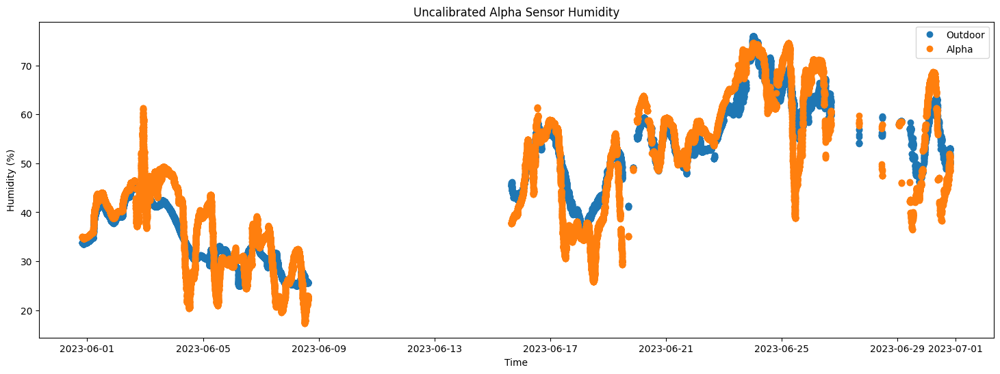

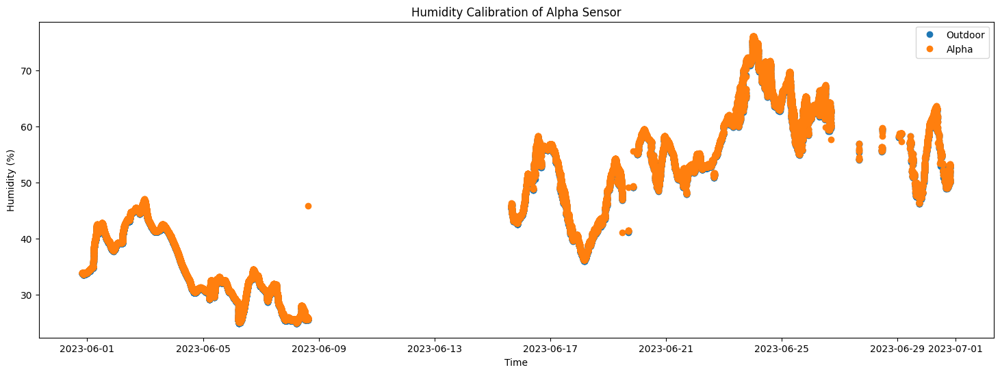

In [39]:
fig, ax = plt.subplots(figsize=(18,6))
ax.plot(dfMod.index, dfMod['rh'], 'o', label='Outdoor')
ax.plot(dfMod.index, dfAlp['sample_rh'], 'o', label='Alpha')


ax.set_ylabel('Humidity (%)')
ax.set_xlabel('Time')
ax.set_title('Uncalibrated Alpha Sensor Humidity')
ax.legend()


for i in range(len(dfAlp['filtered_humidity'])):
   print(dfAlp['filtered_humidity'][i], dfAlp['sample_rh'][i])



# Plot the data
fig, ax = plt.subplots(figsize=(18,6))
ax.plot(dfMod.index, dfMod['rh'], 'o', label='Outdoor')
ax.plot(dfMod.index, dfAlp['filtered_humidity'], 'o', label='Alpha')

ax.set_ylabel('Humidity (%)')
ax.set_xlabel('Time')
ax.set_title('Humidity Calibration of Alpha Sensor')
ax.legend()


    



34.35303165197885 35.01
34.02993187470534 35.0
33.961719452785246 35.01
33.94976049083025 35.0
33.9479180487397 35.0
33.947662881119705 34.98
33.947631125261985 34.99
33.94762766784518 34.96
33.94762736731189 34.96
33.94762735449679 34.94
33.947627356873426 34.95
33.8607091591946 34.95
33.84914926547218 34.93
33.84777676748045 34.91
33.84763748894789 34.88
33.84762716259378 34.89
33.8476271132978 34.87
33.847627297519885 34.87
33.8476273467791 34.88
33.8476273561817 34.86
33.84762735770737 34.86
33.847627357928005 34.85
33.847627357956746 34.84
33.84762735796007 34.83
33.8476273579604 34.84
33.84762735796042 34.82
33.760709159413565 34.81
33.749149265508855 34.8
33.74777676748589 34.79
33.74763748894861 34.79
33.747627162593865 34.79
33.74762711329781 34.77
33.747627297519884 34.77
33.7476273467791 34.78
33.747627356181695 34.77
33.747627357707366 34.76
33.747627357928 34.76
33.747627357956745 34.74
33.74762735796007 34.73
33.7476273579604 34.73
33.660709159413564 34.72
33.649149265508

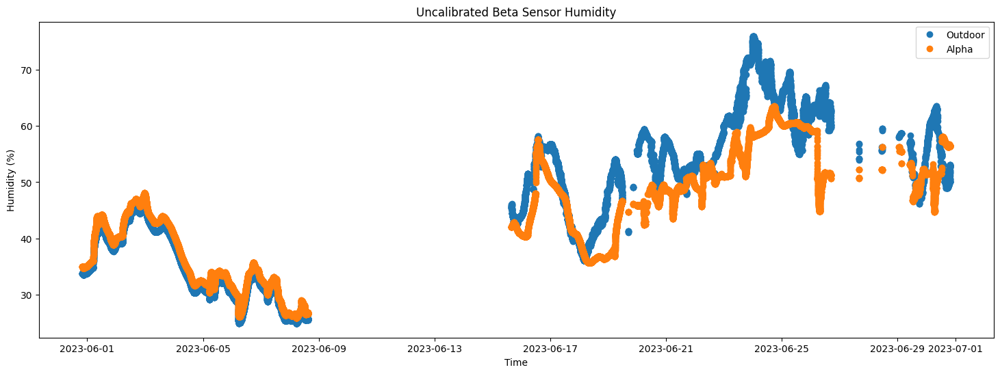

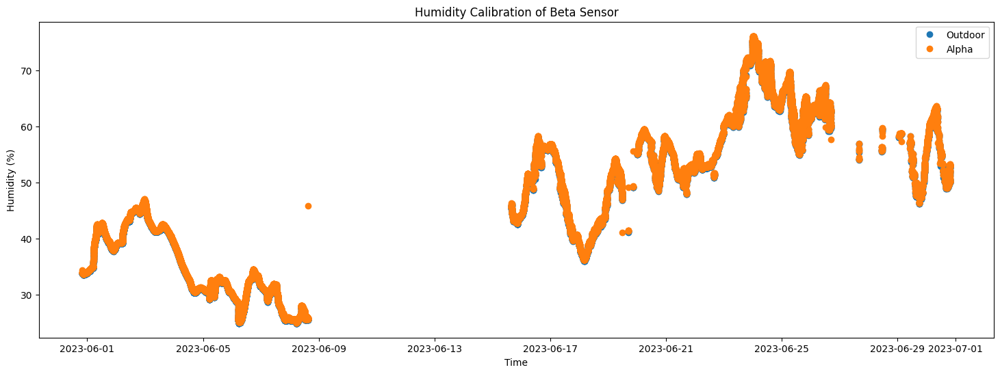

In [41]:

fig, ax = plt.subplots(figsize=(18,6))
ax.plot(dfMod.index, dfMod['rh'], 'o', label='Outdoor')
ax.plot(dfMod.index, dfBet['sample_rh'], 'o', label='Alpha')


ax.set_ylabel('Humidity (%)')
ax.set_xlabel('Time')
ax.set_title('Uncalibrated Beta Sensor Humidity')
ax.legend()


for i in range(len(dfBet['filtered_humidity'])):
   print(dfBet['filtered_humidity'][i], dfBet['sample_rh'][i])



# Plot the data
fig, ax = plt.subplots(figsize=(18,6))
ax.plot(dfMod.index, dfMod['rh'], 'o', label='Outdoor')
ax.plot(dfMod.index, dfBet['filtered_humidity'], 'o', label='Alpha')

ax.set_ylabel('Humidity (%)')
ax.set_xlabel('Time')
ax.set_title('Humidity Calibration of Beta Sensor')
ax.legend()



26.609972529786063 25.56
26.088924593339566 25.57
25.93633555615095 25.58
25.90592590373459 25.59
25.900860546709122 25.58
25.900112567759408 25.59
25.986931293371175 25.6
25.998479377830005 25.59
25.999850677598207 25.6
25.999989867322196 25.61
26.000000193260025 25.61
26.000000244142363 25.62
26.0000000603443 25.62
26.000000011166012 25.62
26.00000000177654 25.63
26.000000000252772 25.64
26.00000000003238 25.64
26.000000000003666 25.65
26.000000000000345 25.65
26.00000000000002 25.65
26.0 25.65
26.0 25.66
26.0 25.66
26.0 25.67
26.0 25.67
26.0 25.67
26.0 25.69
26.0 25.7
26.0 25.7
26.0 25.71
26.08691819854685 25.71
26.098478092451565 25.71
26.09985059047453 25.72
26.099989869011804 25.72
26.100000195366547 25.73
26.100000244662606 25.73
26.100000060440532 25.73
26.10000001118132 25.74
26.10000000177872 25.74
26.10000000025305 25.75
26.100000000032413 25.76
26.10000000000367 25.75
26.100000000000346 25.76
26.100000000000023 25.76
26.1 25.76
26.1 25.77
26.1 25.78
26.1 25.78
26.1 25.78
26

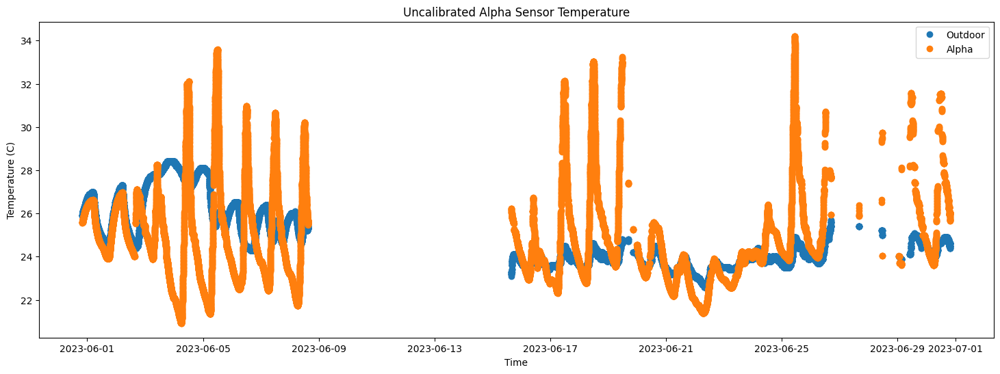

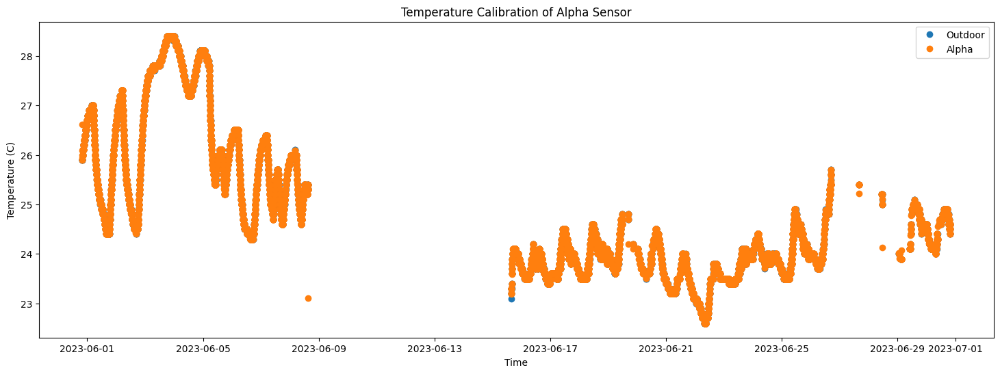

In [43]:
fig, ax = plt.subplots(figsize=(18,6))
ax.plot(dfMod.index, dfMod['temp'], 'o', label='Outdoor')
ax.plot(dfMod.index, dfAlp['sample_temp'], 'o', label='Alpha')


ax.set_ylabel('Temperature (C)')
ax.set_xlabel('Time')
ax.set_title('Uncalibrated Alpha Sensor Temperature')
ax.legend()


for i in range(len(dfAlp['filtered_temperature'])):
    
    print(dfAlp['filtered_temperature'][i], dfAlp['sample_temp'][i])


# Plot the data
fig, ax = plt.subplots(figsize=(18,6))

ax.plot(dfMod.index, dfMod['temp'], 'o', label='Outdoor')
ax.plot(dfMod.index, dfAlp['filtered_temperature'], 'o', label='Alpha')

ax.set_ylabel('Temperature (C)')
ax.set_xlabel('Time')
ax.set_title('Temperature Calibration of Alpha Sensor')
ax.legend()

26.39368267017601 25.55
26.033461537619534 25.55
25.92581943114493 25.54
25.90422583851566 25.55
25.900615421991088 25.55
25.900080733831604 25.57
25.986927623858993 25.58
25.998479023160428 25.58
25.999850654633523 25.58
25.999989868070358 25.59
26.000000193894696 25.59
26.00000024429454 25.6
26.000000060372095 25.6
26.000000011170396 25.6
26.00000000177716 25.61
26.00000000025285 25.61
26.000000000032387 25.62
26.000000000003666 25.62
26.000000000000345 25.62
26.00000000000002 25.63
26.0 25.64
26.0 25.64
26.0 25.64
26.0 25.65
26.0 25.65
26.0 25.64
26.0 25.66
26.0 25.66
26.0 25.68
26.0 25.66
26.08691819854685 25.68
26.098478092451565 25.69
26.09985059047453 25.69
26.099989869011804 25.7
26.100000195366547 25.7
26.100000244662606 25.7
26.100000060440532 25.71
26.10000001118132 25.71
26.10000000177872 25.71
26.10000000025305 25.71
26.100000000032413 25.72
26.10000000000367 25.73
26.100000000000346 25.73
26.100000000000023 25.73
26.1 25.73
26.1 25.74
26.1 25.73
26.1 25.75
26.1 25.74
26.1

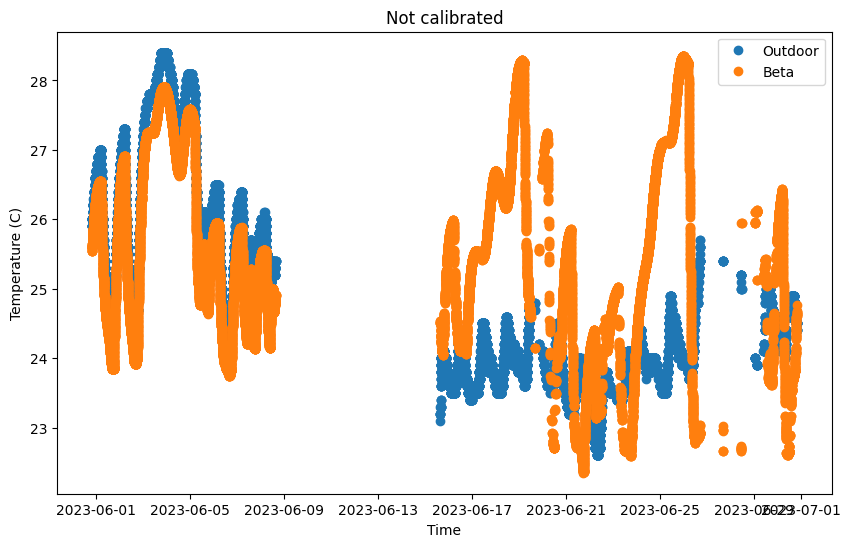

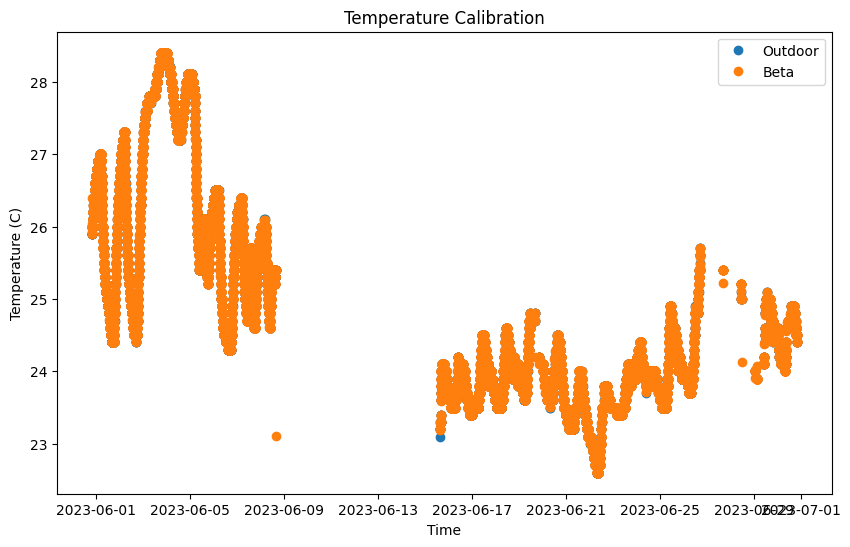

In [25]:

fig, ax = plt.subplots(figsize=(10,6))
ax.plot(dfMod.index, dfMod['temp'], 'o', label='Outdoor')
ax.plot(dfMod.index, dfBet['sample_temp'], 'o', label='Beta')


ax.set_ylabel('Temperature (C)')
ax.set_xlabel('Time')
ax.set_title('Not calibrated')
ax.legend()


for i in range(len(dfBet['filtered_temperature'])):

    print(dfBet['filtered_temperature'][i], dfBet['sample_temp'][i])


# Plot the data
fig, ax = plt.subplots(figsize=(10,6))

ax.plot(dfMod.index, dfMod['temp'], 'o', label='Outdoor')
ax.plot(dfMod.index, dfBet['filtered_temperature'], 'o', label='Beta')

ax.set_ylabel('Temperature (C)')
ax.set_xlabel('Time')
ax.set_title('Temperature Calibration')
ax.legend()



7.822232558139535 8.213
7.475060878027682 8.423
7.942179891658622 8.133
8.393987352018849 8.617
7.946990338844881 8.045
7.398665444166714 7.7
7.384950729710032 7.781
7.453011286779363 8.701
8.028006020336553 8.397
7.893811604818352 8.059
8.091650220628692 9.11
7.308605395063819 8.341
7.484432402542262 8.162
7.2070768565628915 8.604
7.853790674695252 7.699
7.96413601663328 7.897
7.891334623147989 7.975
8.036891755544175 8.2
8.239911856657754 7.693
8.224354724261566 6.479
7.817568740728085 8.115
8.157838615810341 8.218
7.865620483463085 7.89
7.38325808813764 8.45
7.963817117697926 7.592
8.559139564524703 8.003
7.733681108356363 9.09
8.146934176487974 8.751
8.869086678519357 8.241
8.824479707843983 9.308
8.9469005698784 8.775
8.634486939274934 8.351
8.798348128643982 8.981
8.963406213268078 9.487
8.631449209492908 8.973
8.575837540364047 9.233
8.314899494432108 9.428
8.784300187528894 8.584
9.02103658651168 9.171
8.542223084529232 8.253
8.22855967266537 8.933
8.060236336296736 9.627
8.500

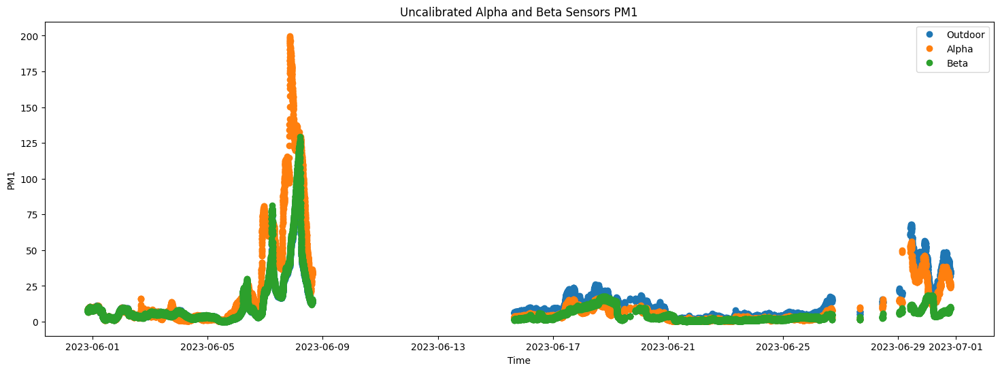

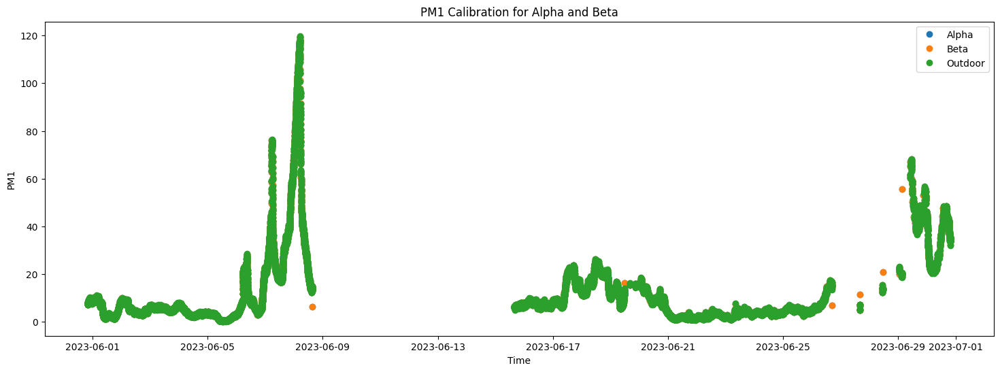

In [42]:

fig, ax = plt.subplots(figsize=(18,6))
ax.plot(dfMod.index, dfMod['pm1'], 'o', label='Outdoor')

ax.plot(dfMod.index, dfAlp['pm1'], 'o', label='Alpha')
ax.plot(dfMod.index, dfBet['pm1'], 'o', label='Beta')

ax.set_ylabel('PM1')
ax.set_xlabel('Time')
ax.set_title('Uncalibrated Alpha and Beta Sensors PM1')
ax.legend()


for i in range(len(dfAlp['filtered_pm1'])):

    print(dfAlp['filtered_pm1'][i], dfAlp['pm1'][i])


# Plot the data
fig, ax = plt.subplots(figsize=(18,6))
ax.plot(dfMod.index, dfAlp['filtered_pm1'], 'o', label='Alpha')
ax.plot(dfMod.index, dfBet['filtered_pm1'], 'o', label='Beta')
ax.plot(dfMod.index, dfMod['pm1'], 'o', label='Outdoor')


ax.set_ylabel('PM1')
ax.set_xlabel('Time')
ax.set_title('PM1 Calibration for Alpha and Beta')
ax.legend()


7.875023255813954 8.329
7.504715397923875 8.537
8.027534511638653 8.33
8.517467276323705 8.738
8.060205270823197 8.097
7.491610007197242 7.816
7.449749514613641 7.964
7.5922475838215195 8.806
8.132939816627399 8.532
7.994267913439213 8.179
8.191194101975725 9.225
7.352675173587825 8.484
7.604115071512377 8.345
7.372262045399419 8.763
7.951314556433546 7.79
8.049591505401324 7.994
8.020763952902607 8.109
8.183491106574898 8.338
8.339000520072526 7.822
8.396750591507088 6.528
7.90344757581149 8.23
8.237510401370677 8.438
8.021232446895606 8.063
7.472181758779892 8.628
8.080072715769825 7.694
8.70524570401728 8.171
7.802595792289734 9.165
8.219252036467944 8.969
8.9341795725881 8.364
8.98695111209323 9.395
9.156811887600972 8.919
8.726273696620279 8.586
8.895510506215638 9.106
9.058727415676517 9.596
8.841188266641696 9.022
8.677194555351509 9.43
8.46887875389804 9.578
8.916974752832674 8.782
9.128249724341547 9.324
8.593194789865338 8.394
8.327702825910793 9.012
8.207294310543178 9.744
8

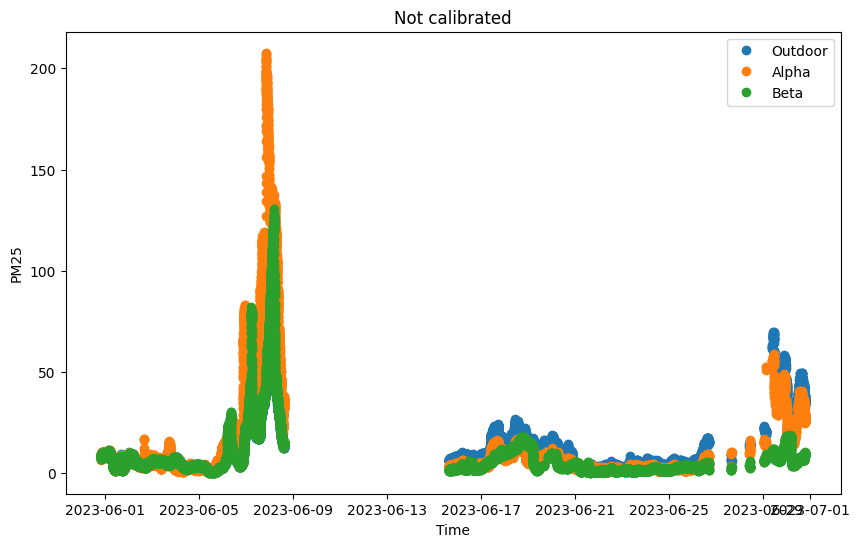

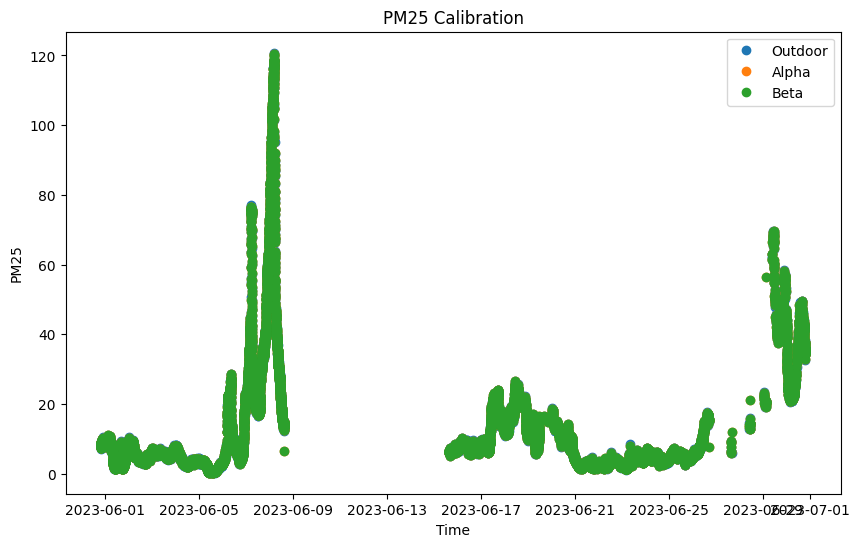

In [27]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(dfMod.index, dfMod['pm25'], 'o', label='Outdoor')
ax.plot(dfMod.index, dfAlp['pm25'], 'o', label='Alpha')
ax.plot(dfMod.index, dfBet['pm25'], 'o', label='Beta')

ax.set_ylabel('PM25')
ax.set_xlabel('Time')
ax.set_title('Not calibrated')
ax.legend()

for i in range(len(dfAlp['filtered_pm25'])):
    print(dfAlp['filtered_pm25'][i], dfAlp['pm25'][i])

# Plot the data with PM25 calibration
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(dfMod.index, dfMod['pm25'], 'o', label='Outdoor')
ax.plot(dfMod.index, dfAlp['filtered_pm25'], 'o', label='Alpha')
ax.plot(dfMod.index, dfBet['filtered_pm25'], 'o', label='Beta')

ax.set_ylabel('PM25')
ax.set_xlabel('Time')
ax.set_title('PM25 Calibration')
ax.legend()


8.08906976744186 8.329
7.533705017301038 8.537
8.069339224859931 8.449
8.787165838490115 8.8
8.095983080581002 8.097
7.495844762822582 7.816
7.45017714022842 8.025
8.103357899312009 8.806
8.20091204004678 8.594
8.045796715747725 8.179
8.279495958935131 9.225
7.364288412507869 8.543
7.690654978615523 8.404
7.424577295835368 11.435
7.958102196319688 7.79
8.092093706670848 7.994
8.02638807594676 8.109
8.184154755020408 8.338
8.339067206631652 8.49
8.438476147037447 6.528
7.9089963159578085 8.23
8.40331368329094 8.629
8.124096999080024 8.125
7.4855451583597645 8.869
8.081613791065001 7.694
8.746246317913595 8.171
7.808038615938985 9.165
8.219896801847273 9.842
9.153278628187168 8.364
9.103005032884763 9.395
9.213551223338216 9.682
8.733545837207375 8.711
8.935447772152186 9.847
9.224805335071734 9.831
9.028340812700698 9.022
8.742611418974521 12.165
8.563230817597974 10.609
8.92934784013619 8.836
9.171414315376003 9.385
10.599742938286342 8.451
8.63533173669999 9.012
8.456469473846235 9.86

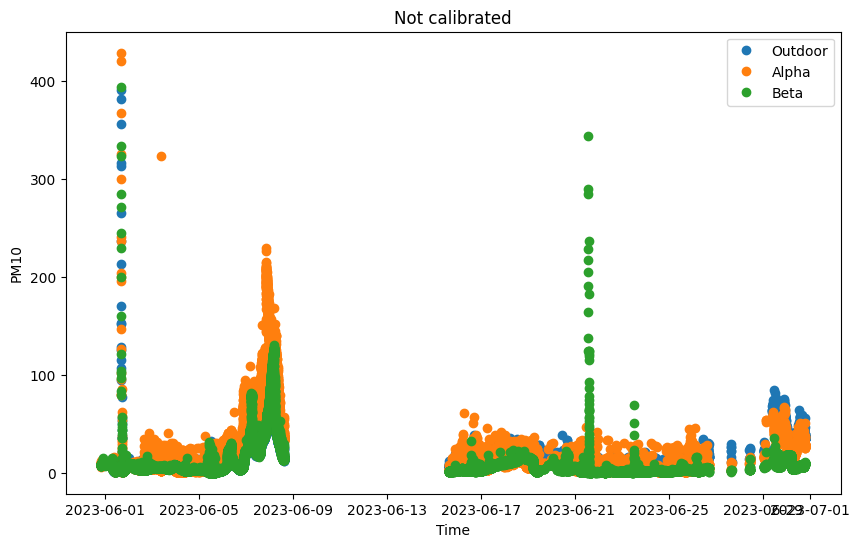

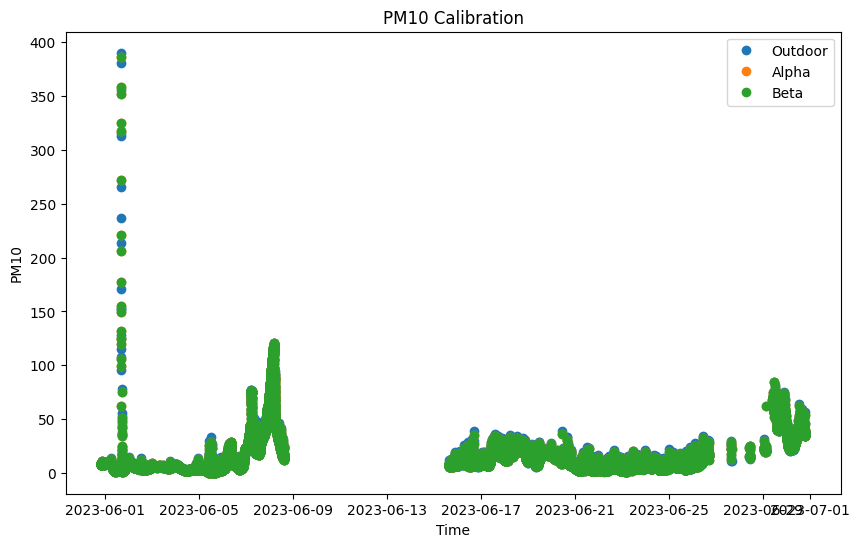

In [28]:

fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(dfMod.index, dfMod['pm10'], 'o', label='Outdoor')
ax.plot(dfMod.index, dfAlp['pm10'], 'o', label='Alpha')
ax.plot(dfMod.index, dfBet['pm10'], 'o', label='Beta')

ax.set_ylabel('PM10')
ax.set_xlabel('Time')
ax.set_title('Not calibrated')
ax.legend()

for i in range(len(dfAlp['filtered_pm10'])):
    print(dfAlp['filtered_pm10'][i], dfAlp['pm10'][i])

# Plot the data with PM10 calibration
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(dfMod.index, dfMod['pm10'], 'o', label='Outdoor')
ax.plot(dfMod.index, dfAlp['filtered_pm10'], 'o', label='Alpha')
ax.plot(dfMod.index, dfBet['filtered_pm10'], 'o', label='Beta')

ax.set_ylabel('PM10')
ax.set_xlabel('Time')
ax.set_title('PM10 Calibration')
ax.legend()


In [29]:
# Assume you have new sensor measurements in variables 'new_measurement_alpha' and 'new_measurement_beta'
new_dfAlp = pd.read_csv('alpha_july.csv',parse_dates=['timestamp_local'],index_col='timestamp_local')
new_dfBet = pd.read_csv('beta_july.csv', parse_dates=['timestamp_local'], index_col='timestamp_local')
new_dfMod = pd.read_csv('outdoor_july.csv',parse_dates=['timestamp_local'],index_col='timestamp_local')
new_dfAlp = new_dfAlp.sort_index(ascending=True)
new_dfBet = new_dfBet.sort_index(ascending=True)


Alpha Sensor: Measured Humidity: 49.82, Estimated Humidity: 51.99, Bias Estimate: 0.84
Alpha Sensor: Measured Humidity: 49.83, Estimated Humidity: 51.99, Bias Estimate: 0.84
Alpha Sensor: Measured Humidity: 49.81, Estimated Humidity: 51.99, Bias Estimate: 0.84
Alpha Sensor: Measured Humidity: 49.81, Estimated Humidity: 51.99, Bias Estimate: 0.84
Alpha Sensor: Measured Humidity: 49.85, Estimated Humidity: 51.99, Bias Estimate: 0.84
Alpha Sensor: Measured Humidity: 49.82, Estimated Humidity: 51.99, Bias Estimate: 0.84
Alpha Sensor: Measured Humidity: 49.79, Estimated Humidity: 51.98, Bias Estimate: 0.84
Alpha Sensor: Measured Humidity: 49.75, Estimated Humidity: 51.98, Bias Estimate: 0.84
Alpha Sensor: Measured Humidity: 49.78, Estimated Humidity: 51.98, Bias Estimate: 0.84
Alpha Sensor: Measured Humidity: 49.76, Estimated Humidity: 51.98, Bias Estimate: 0.84
Alpha Sensor: Measured Humidity: 49.79, Estimated Humidity: 51.98, Bias Estimate: 0.84
Alpha Sensor: Measured Humidity: 49.73, Est

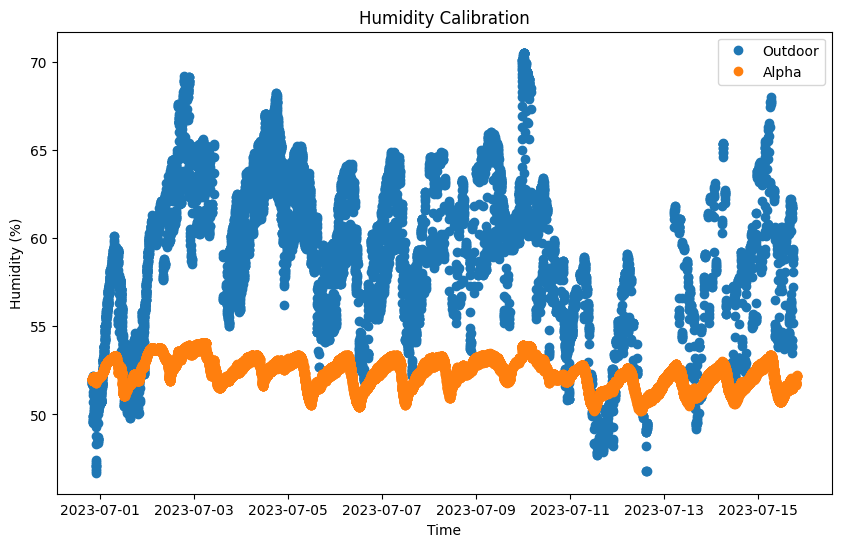

In [30]:

new_filtered_humidity_alpha = []

for measurement_alpha in new_dfAlp['sample_rh']:

    new_measurement_vector = np.array([measurement_alpha, 1])

# Kalman filter predict and update steps for the new data points
# Update Step
    measurement_residual_alpha = new_measurement_vector - np.dot(humidity_measurement_matrix_alpha, humidity_state_estimate_alpha)
    kalman_gain_alpha = np.dot(np.dot(humidity_covariance_estimate_alpha, humidity_measurement_matrix_alpha.T), np.linalg.inv(np.dot(np.dot(humidity_measurement_matrix_alpha, humidity_covariance_estimate_alpha), humidity_measurement_matrix_alpha.T) + humidity_noise_covariance_matrix_alpha))
    humidity_state_estimate = humidity_state_estimate_alpha + np.dot(kalman_gain_alpha, measurement_residual_alpha)
    humidity_covariance_estimate = np.dot((np.eye(2) - np.dot(kalman_gain_alpha, humidity_measurement_matrix_alpha)), humidity_covariance_estimate_alpha)

    # Extract humidity estimates and biases from the updated state vector
    humidity_alpha_estimate = humidity_state_estimate[0]
    humidity_bias_estimate = humidity_state_estimate[1]

# Output the estimates for the new data points
    print(f"Alpha Sensor: Measured Humidity: {measurement_alpha:.2f}, Estimated Humidity: {humidity_alpha_estimate:.2f}, Bias Estimate: {humidity_bias_alpha_estimate:.2f}")
    new_filtered_humidity_alpha.append(humidity_alpha_estimate)

new_dfAlp['filtered_humidity'] = new_filtered_humidity_alpha

print(np.min(new_dfAlp['filtered_humidity']))
print(np.max(new_dfAlp['filtered_humidity']))
print(np.max(new_dfMod['rh']))
print(np.min(new_dfMod['rh']))
stretched_data = (new_dfAlp['filtered_humidity'] - np.min(new_dfAlp['filtered_humidity'])) * (np.max(new_dfMod['rh']) - np.min(new_dfMod['rh'])) / (np.max(new_dfAlp['filtered_humidity']) - np.min(new_dfAlp['filtered_humidity'])) + np.min(new_dfMod['rh'])


# Plot the data
fig, ax = plt.subplots(figsize=(10,6))
# ax.plot(new_dfAlp.index, new_dfAlp['sample_rh'], 'o', label='Alpha')
ax.plot(new_dfMod.index, new_dfMod['rh'], 'o', label='Outdoor')
ax.plot(new_dfAlp.index, new_dfAlp['filtered_humidity'], 'o', label='Alpha')
# ax.plot(new_dfAlp.index, stretched_data, 'o', label='Stretched_Alpha')


ax.set_ylabel('Humidity (%)')
ax.set_xlabel('Time')
ax.set_title('Humidity Calibration')
ax.legend()


Beta Sensor: Measured Humidity: 35.01, Estimated Humidity: 34.35, Bias Estimate: 1.28
Beta Sensor: Measured Humidity: 35.00, Estimated Humidity: 34.03, Bias Estimate: 1.01
Beta Sensor: Measured Humidity: 35.01, Estimated Humidity: 33.96, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 35.00, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 35.00, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 34.98, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 34.99, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 34.96, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 34.96, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 34.94, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 34.95, Estimated Humidity: 33.95, Bias Estimate: 0.98
Beta Sensor: Measured Humidity: 34.95, Estimated Humid

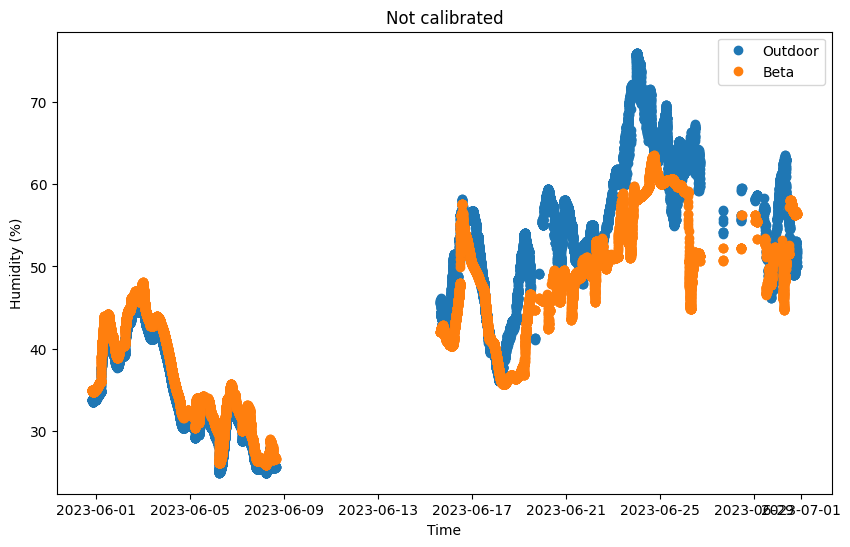

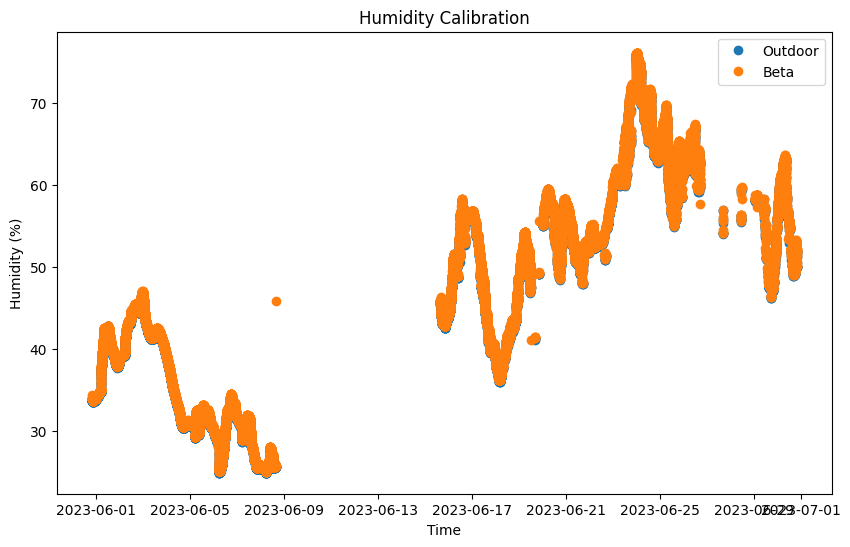

In [31]:
humidity_measurement_matrix_beta = np.array([[1, 0],  # For the ground truth humidity_beta
                                            [0, 1]])

humidity_noise_covariance_matrix_beta = np.diag([1, 1])

humidity_initial_state_beta = [humidity_df['beta_sensor'][0], humidity_bias_beta]

humidity_process_noise_covariance_beta = np.diag([0.5, 0.5])

humidity_state_estimate_beta = np.array(humidity_initial_state_beta)
humidity_covariance_estimate_beta = np.diag([0.1, 1])  

filtered_humidity_beta = []
i = 0
for measurement_beta in humidity_df['beta_sensor']:
    if i < dfBet.index.size - 1:
        i = i + 1

    delta_time_beta = dfBet.index[i] - dfBet.index[i-1]
    
    # Kalman filter predict and update steps
    humidity_state_transition_beta = np.array([[1, delta_time_beta.seconds / 60],
                                              [0, 1]])
    humidity_state_estimate_beta = np.dot(humidity_state_transition_beta, humidity_state_estimate_beta)
    humidity_covariance_estimate_beta = np.dot(np.dot(humidity_state_transition_beta, humidity_covariance_estimate_beta), humidity_state_transition_beta.T) + humidity_process_noise_covariance_beta
    measurement_vector_beta = np.array([humidity_ground_truth[i], 1])  # Add the ground truth measurements
      # Update Step
    measurement_residual_beta = measurement_vector_beta - np.dot(humidity_measurement_matrix_beta, humidity_state_estimate_beta)

    # Adjust the humidity_noise_covariance_matrix for the additional measurements
    humidity_noise_covariance_matrix_adjusted_beta = np.diag([0.1, 0.1])

    kalman_gain_beta = np.dot(np.dot(humidity_covariance_estimate_beta, humidity_measurement_matrix_beta.T), np.linalg.inv(np.dot(np.dot(humidity_measurement_matrix_beta, humidity_covariance_estimate_beta), humidity_measurement_matrix_beta.T) + humidity_noise_covariance_matrix_adjusted_beta))
    humidity_state_estimate_beta = humidity_state_estimate_beta + np.dot(kalman_gain_beta, measurement_residual_beta)
    humidity_covariance_estimate_beta = np.dot((np.eye(2) - np.dot(kalman_gain_beta, humidity_measurement_matrix_beta)), humidity_covariance_estimate_beta)

    # Extract humidity estimates and biases from the state vector
    humidity_beta_estimate = humidity_state_estimate_beta[0]
    humidity_bias_beta_estimate = humidity_state_estimate_beta[1]
 

    # Output the estimates
    print(f"Beta Sensor: Measured Humidity: {measurement_beta:.2f}, Estimated Humidity: {humidity_beta_estimate:.2f}, Bias Estimate: {humidity_bias_beta_estimate:.2f}")

    filtered_humidity_beta.append(humidity_beta_estimate)


dfBet['filtered_humidity'] = filtered_humidity_beta



fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(dfMod.index, dfMod['rh'], 'o', label='Outdoor')
ax.plot(dfMod.index, dfBet['sample_rh'], 'o', label='Beta')

ax.set_ylabel('Humidity (%)')
ax.set_xlabel('Time')
ax.set_title('Not calibrated')
ax.legend()


for i in range(len(dfBet['filtered_humidity'])):
    print(dfBet['filtered_humidity'][i], dfBet['sample_rh'][i])

# Plot the data
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(dfMod.index, dfMod['rh'], 'o', label='Outdoor')
ax.plot(dfMod.index, dfBet['filtered_humidity'], 'o', label='Beta')

ax.set_ylabel('Humidity (%)')
ax.set_xlabel('Time')
ax.set_title('Humidity Calibration')
ax.legend()


Beta Sensor: Measured Humidity: 56.40, Estimated Humidity: 52.58, Bias Estimate: 0.84
Beta Sensor: Measured Humidity: 56.42, Estimated Humidity: 52.90, Bias Estimate: 0.84
Beta Sensor: Measured Humidity: 56.40, Estimated Humidity: 53.16, Bias Estimate: 0.84
Beta Sensor: Measured Humidity: 56.37, Estimated Humidity: 53.39, Bias Estimate: 0.84
Beta Sensor: Measured Humidity: 56.37, Estimated Humidity: 53.59, Bias Estimate: 0.84
Beta Sensor: Measured Humidity: 56.37, Estimated Humidity: 53.76, Bias Estimate: 0.84
Beta Sensor: Measured Humidity: 56.36, Estimated Humidity: 53.91, Bias Estimate: 0.84
Beta Sensor: Measured Humidity: 56.36, Estimated Humidity: 54.05, Bias Estimate: 0.84
Beta Sensor: Measured Humidity: 56.33, Estimated Humidity: 54.17, Bias Estimate: 0.84
Beta Sensor: Measured Humidity: 56.29, Estimated Humidity: 54.27, Bias Estimate: 0.84
Beta Sensor: Measured Humidity: 56.26, Estimated Humidity: 54.37, Bias Estimate: 0.84
Beta Sensor: Measured Humidity: 56.27, Estimated Humid

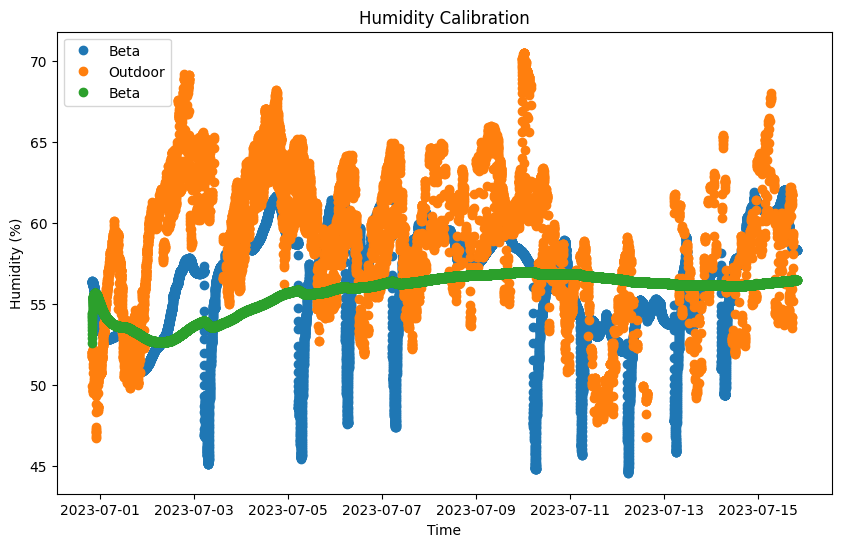

In [32]:

new_filtered_humidity_beta = []

for measurement_beta in new_dfBet['sample_rh']:

    new_measurement_vector = np.array([measurement_beta, 1])

    # Kalman filter predict and update steps for the new data points
    # Update Step
    measurement_residual_beta = new_measurement_vector - np.dot(humidity_measurement_matrix_beta, humidity_state_estimate_beta)
    kalman_gain_beta = np.dot(np.dot(humidity_covariance_estimate_beta, humidity_measurement_matrix_beta.T), np.linalg.inv(np.dot(np.dot(humidity_measurement_matrix_beta, humidity_covariance_estimate_beta), humidity_measurement_matrix_beta.T) + humidity_noise_covariance_matrix_beta))
    humidity_state_estimate_beta = humidity_state_estimate_beta + np.dot(kalman_gain_beta, measurement_residual_beta)
    humidity_covariance_estimate_beta = np.dot((np.eye(2) - np.dot(kalman_gain_beta, humidity_measurement_matrix_beta)), humidity_covariance_estimate_beta)

    # Extract humidity estimates and biases from the updated state vector
    humidity_beta_estimate = humidity_state_estimate_beta[0]
    humidity_bias_estimate = humidity_state_estimate_beta[1]

    # Output the estimates for the new data points
    print(f"Beta Sensor: Measured Humidity: {measurement_beta:.2f}, Estimated Humidity: {humidity_beta_estimate:.2f}, Bias Estimate: {humidity_bias_beta_estimate:.2f}")
    new_filtered_humidity_beta.append(humidity_beta_estimate)

new_dfBet['filtered_humidity'] = new_filtered_humidity_beta

# Plot the data
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(new_dfBet.index, new_dfBet['sample_rh'], 'o', label='Beta')
ax.plot(new_dfMod.index, new_dfMod['rh'], 'o', label='Outdoor')
ax.plot(new_dfBet.index, new_dfBet['filtered_humidity'], 'o', label='Beta')

ax.set_ylabel('Humidity (%)')
ax.set_xlabel('Time')
ax.set_title('Humidity Calibration')
ax.legend()


Alpha Sensor: Measured Temperature: 25.73, Estimated Temperature: 24.52, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.73, Estimated Temperature: 24.62, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.73, Estimated Temperature: 24.71, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.74, Estimated Temperature: 24.78, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.74, Estimated Temperature: 24.84, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.75, Estimated Temperature: 24.90, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.75, Estimated Temperature: 24.95, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.76, Estimated Temperature: 25.00, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.76, Estimated Temperature: 25.04, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.77, Estimated Temperature: 25.07, Bias Estimate: 0.00
Alpha Sensor: Measured Temperature: 25.77, Estimated Temperature: 25.1

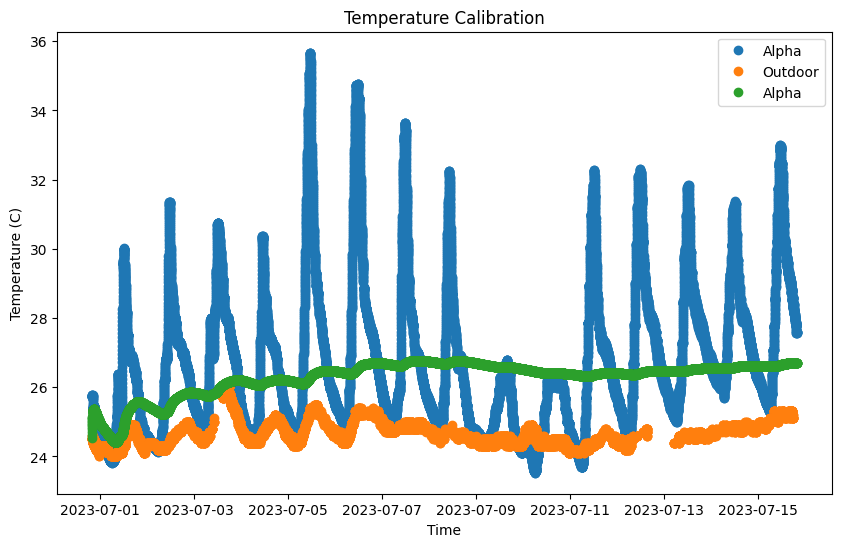

In [33]:
new_filtered_temperature_alpha = []

for measurement_alpha in new_dfAlp['sample_temp']:

    new_measurement_vector = np.array([measurement_alpha, 1])

    # Kalman filter predict and update steps for the new data points
    # Update Step
    measurement_residual_alpha = new_measurement_vector - np.dot(temperature_measurement_matrix_alpha, temperature_state_estimate_alpha)
    kalman_gain_alpha = np.dot(np.dot(temperature_covariance_estimate_alpha, temperature_measurement_matrix_alpha.T), np.linalg.inv(np.dot(np.dot(temperature_measurement_matrix_alpha, temperature_covariance_estimate_alpha), temperature_measurement_matrix_alpha.T) + temperature_noise_covariance_matrix_alpha))
    temperature_state_estimate_alpha = temperature_state_estimate_alpha + np.dot(kalman_gain_alpha, measurement_residual_alpha)
    temperature_covariance_estimate_alpha = np.dot((np.eye(2) - np.dot(kalman_gain_alpha, temperature_measurement_matrix_alpha)), temperature_covariance_estimate_alpha)

    # Extract temperature estimates and biases from the updated state vector
    temperature_alpha_estimate = temperature_state_estimate_alpha[0]
    temperature_bias_estimate = temperature_state_estimate_alpha[1]

    # Output the estimates for the new data points
    print(f"Alpha Sensor: Measured Temperature: {measurement_alpha:.2f}, Estimated Temperature: {temperature_alpha_estimate:.2f}, Bias Estimate: {temperature_bias_alpha_estimate:.2f}")
    new_filtered_temperature_alpha.append(temperature_alpha_estimate)

new_dfAlp['filtered_temperature'] = new_filtered_temperature_alpha

# Plot the data
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(new_dfAlp.index, new_dfAlp['sample_temp'], 'o', label='Alpha')
ax.plot(new_dfMod.index, new_dfMod['temp'], 'o', label='Outdoor')
ax.plot(new_dfAlp.index, new_dfAlp['filtered_temperature'], 'o', label='Alpha')

ax.set_ylabel('Temperature (C)')
ax.set_xlabel('Time')
ax.set_title('Temperature Calibration')
ax.legend()
